In [ ]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


In [2]:
import importlib
import pickle

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split

import utils
importlib.reload(utils)

from utils import (
    calculate_accuracy_by_gender_and_ethnicity,
    create_dataset,
    evaluate_and_predict,
    find_prototype_and_criticism,
    plot_accuracy_comparison_by_group,
    plot_comparison_metric,
    plot_confusion_matrix,
    prepare_comparison_data,
    prepare_dataframe,
    predict_xai,
)

In [3]:
np.random.seed(42)
tf.random.set_seed(42)

In [4]:
DATASET_DIR = "datasets/utkface"
IMG_DIM = 200
INPUT_SHAPE = (IMG_DIM, IMG_DIM, 3)

FIXED_KERNEL_SIZE = (3, 3)
MIN_DENSE_UNITS = 16
NUM_AGE_CLASSES = 9

In [5]:
# Only process information for age class <= 8 (80-89) removing 200~ rows

df_full = prepare_dataframe(DATASET_DIR)
df = df_full[df_full['Age_Class'] <= 8].copy()

shuffled_df = df.sample(frac=1, random_state=42).reset_index(drop=True)

In [6]:
shuffled_df

,Image_Path,Age,Gender,Ethnicity,Age_Class
0,datasets/utkface/35_0_0_20170117191042138.jpg....,35,0,0,3
1,datasets/utkface/4_1_4_20161221193345109.jpg.c...,4,1,4,0
2,datasets/utkface/28_0_3_20170119211807137.jpg....,28,0,3,2
3,datasets/utkface/16_1_0_20170104013358122.jpg....,16,1,0,1
4,datasets/utkface/3_1_0_20170109194247387.jpg.c...,3,1,0,0
...,...,...,...,...,...
23531,datasets/utkface/32_1_0_20170117134737646.jpg....,32,1,0,3
23532,datasets/utkface/68_1_1_20170113012709282.jpg....,68,1,1,6
23533,datasets/utkface/25_1_1_20170112192328981.jpg....,25,1,1,2
23534,datasets/utkface/16_0_0_20170110232714508.jpg....,16,0,0,1


In [7]:
# Train-test split, used for evaluating final model
df_train, df_test = train_test_split(shuffled_df, test_size=0.2, random_state=42)

# Train-val split, used for evaluating intermediate model
df_train_tune, df_val_tune = train_test_split(df_train, test_size=0.2, random_state=42)

In [8]:
# both models have batch_size 64

with open("models/best_hyperparameters.pkl", 'rb') as f:
    loaded_best_hps = pickle.load(f)
    batch_size = loaded_best_hps.values['batch_size']

batch_size

64

In [10]:
test_ds = create_dataset(
    df_test['Image_Path'],
    df_test['Age_Class'],
    batch_size=batch_size,
    img_height=200,
    img_width=200,
    is_training=False
)

results = {}

In [12]:
results['base'], df_base_results, base_model = evaluate_and_predict(
    model_path="models/base_model_trained.h5",
    model_name="Base Model",
    test_dataset=test_ds,
    true_labels_df=df_test.copy()
)

c:\Users\maduj\anaconda3\envs\texai\Lib\site-packages\keras\src\optimizers\base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Classification Report:
              precision    recall  f1-score   support

         0-9       0.85      0.96      0.90       609
       10-19       0.73      0.38      0.50       309
       20-29       0.70      0.82      0.75      1502
       30-39       0.48      0.48      0.48       872
       40-49       0.51      0.24      0.33       450
       50-59       0.47      0.58      0.52       484
       60-69       0.38      0.36      0.37       249
       70-79       0.37      0.27      0.31       138
       80-89       0.52      0.36      0.42        95

    accuracy                           0.62      4708
   macro avg       0.56      0.49      0.51      4708
weighted avg       0.61      0.62      0.60      4708



In [15]:
print(f"Base Model Accuracy: {results['base']['classification_report']['accuracy']:.{4}f}")

Base Model Accuracy: 0.6170


In [12]:
results['balanced'], df_balanced_results, balanced_model = evaluate_and_predict(
    model_path="models/class_weight_model_trained.h5",
    model_name="Class Weight Model",
    test_dataset=test_ds,
    true_labels_df=df_test.copy()
)

/home/hylke/miniconda3/envs/ageclassification/lib/python3.10/site-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Classification Report:
              precision    recall  f1-score   support

         0-9       0.95      0.89      0.92       609
       10-19       0.57      0.68      0.62       309
       20-29       0.76      0.67      0.71      1502
       30-39       0.44      0.42      0.43       872
       40-49       0.35      0.46      0.39       450
       50-59       0.46      0.50      0.48       484
       60-69       0.34      0.25      0.29       249
       70-79       0.29      0.33      0.31       138
       80-89       0.47      0.63      0.54        95

    accuracy                           0.58      4708
   macro avg       0.51      0.54      0.52      4708
weighted avg       0.60      0.58      0.59      4708



In [17]:
print(f"Balanced Model Accuracy: {results['balanced']['classification_report']['accuracy']:.{4}f}")

Balanced Model Accuracy: 0.5833


In [75]:
df_balanced_results

,Image_Path,Age,Gender,Ethnicity,Age_Class,Predicted_Age_Class,Confidence
12961,UTKFace\45_0_3_20170119200707996.jpg.chip.jpg,45,0,3,4,4,0.592507
17794,UTKFace\7_0_2_20161219190327212.jpg.chip.jpg,7,0,2,0,0,0.620377
8951,UTKFace\31_1_3_20170104223321247.jpg.chip.jpg,31,1,3,3,2,0.528343
911,UTKFace\36_0_0_20170104173013523.jpg.chip.jpg,36,0,0,3,4,0.555032
15180,UTKFace\23_1_1_20170102233446754.jpg.chip.jpg,23,1,1,2,3,0.406403
...,...,...,...,...,...,...,...
3,UTKFace\16_1_0_20170104013358122.jpg.chip.jpg,16,1,0,1,1,0.634910
12498,UTKFace\27_1_1_20170117013821300.jpg.chip.jpg,27,1,1,2,2,0.487844
19313,UTKFace\26_1_0_20170116235853558.jpg.chip.jpg,26,1,0,2,2,0.450662
13987,UTKFace\12_1_0_20170109204206273.jpg.chip.jpg,12,1,0,1,3,0.271766


In [36]:
report_dict_base = results['base']['classification_report']
report_dict_balanced = results['balanced']['classification_report']

In [37]:
num_classes = 9
class_names = [f"{i*10}-{i*10+9}" for i in range(num_classes)]

In [38]:
df_base = pd.DataFrame(report_dict_base).transpose()
df_balanced = pd.DataFrame(report_dict_balanced).transpose()

support_threshold = 500 
minority_filter = df_base['support'] < support_threshold
# remove accuracy
class_filter = ~df_base.index.isin(['accuracy'])
final_filter = minority_filter & class_filter

df_minority_base = df_base[final_filter]
df_minority_balanced = df_balanced[final_filter]

metrics_to_show = ['precision', 'recall', 'f1-score', 'support']
df_minority_base = df_minority_base[metrics_to_show].add_suffix('_Base')
df_minority_balanced = df_minority_balanced[metrics_to_show].add_suffix('_Balanced')

df_comparison = pd.concat([df_minority_base, df_minority_balanced], axis=1)

column_order = []
for metric in ['precision', 'recall', 'f1-score']:
    column_order.extend([f'{metric}_Base', f'{metric}_Balanced'])

column_order.append('support_Base')
df_comparison = df_comparison[column_order]
df_comparison = df_comparison.rename(columns={'support_Base': 'support'})

if df_comparison.empty:
    print(f"No classes found with support below threshold {support_threshold}")
else:
    print(f"\n--- Comparison for Minority Classes (< {support_threshold} support) ---")
    print(df_comparison.round(4))


--- Comparison for Minority Classes (< 500 support) ---
       precision_Base  precision_Balanced  recall_Base  recall_Balanced  \
10-19          0.7329              0.5657       0.3819           0.6828   
40-49          0.5143              0.3457       0.2400           0.4556   
50-59          0.4653              0.4594       0.5826           0.5021   
60-69          0.3797              0.3405       0.3614           0.2530   
70-79          0.3700              0.2930       0.2681           0.3333   
80-89          0.5231              0.4651       0.3579           0.6316   

       f1-score_Base  f1-score_Balanced  support  
10-19         0.5021             0.6188    309.0  
40-49         0.3273             0.3931    450.0  
50-59         0.5174             0.4798    484.0  
60-69         0.3704             0.2903    249.0  
70-79         0.3109             0.3119    138.0  
80-89         0.4250             0.5357     95.0  


In [39]:
support_threshold_value = 500
df_comparison_processed, minority_classes_list = prepare_comparison_data(
    report_dict_base,
    report_dict_balanced,
    support_threshold_value
)

In [40]:
df_comparison_processed

,precision_Base,precision_Balanced,recall_Base,recall_Balanced,f1-score_Base,f1-score_Balanced,support
0-9,0.846154,0.953982,0.957307,0.885057,0.898305,0.918228,609.0
10-19,0.732919,0.565684,0.381877,0.682848,0.502128,0.618768,309.0
20-29,0.695039,0.759398,0.820905,0.672437,0.752747,0.713277,1502.0
30-39,0.484988,0.435655,0.481651,0.423165,0.483314,0.429319,872.0
40-49,0.514286,0.345700,0.240000,0.455556,0.327273,0.393097,450.0
50-59,0.465347,0.459357,0.582645,0.502066,0.517431,0.479763,484.0
60-69,0.379747,0.340541,0.361446,0.253012,0.370370,0.290323,249.0
70-79,0.370000,0.292994,0.268116,0.333333,0.310924,0.311864,138.0
80-89,0.523077,0.465116,0.357895,0.631579,0.425000,0.535714,95.0


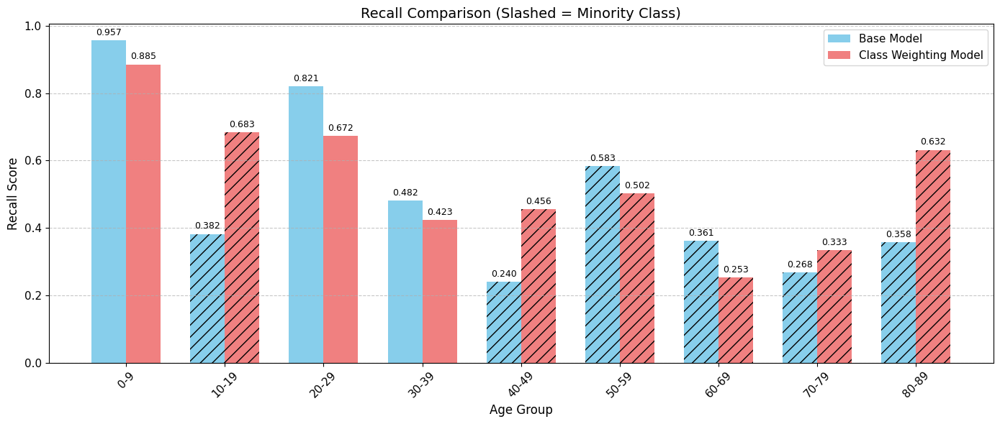

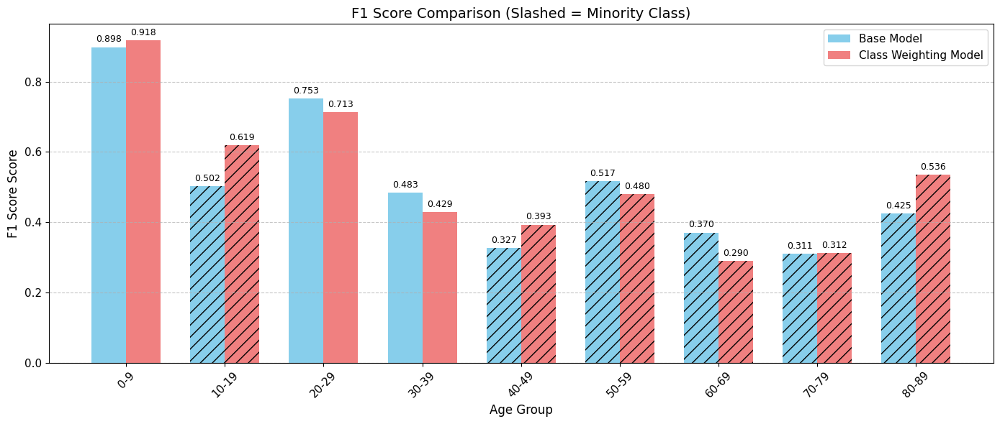

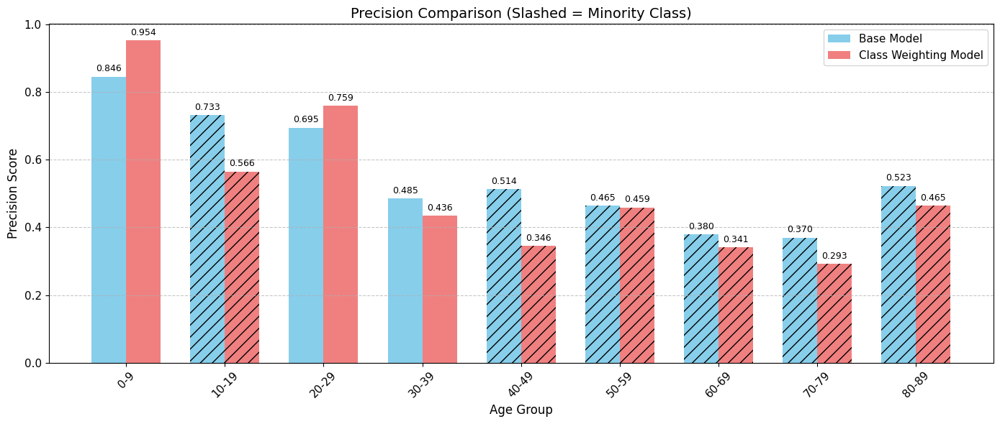

In [62]:
plot_comparison_metric(df_comparison_processed, 'recall', minority_classes_list)
plot_comparison_metric(df_comparison_processed, 'f1-score', minority_classes_list)
plot_comparison_metric(df_comparison_processed, 'precision', minority_classes_list)

[[0.95730706 0.0180624  0.01477833 0.00492611 0.         0.
  0.00328407 0.00164204 0.        ]
 [0.2394822  0.38187702 0.34304207 0.02588997 0.         0.00970874
  0.         0.         0.        ]
 [0.00865513 0.01464714 0.82090546 0.13382157 0.00399467 0.01664447
  0.00133156 0.         0.        ]
 [0.0103211  0.00573394 0.37729358 0.48165138 0.05619266 0.06422018
  0.00458716 0.         0.        ]
 [0.00222222 0.00666667 0.15555556 0.33555556 0.24       0.24444444
  0.00666667 0.00888889 0.        ]
 [0.00826446 0.00206612 0.0392562  0.1322314  0.08057851 0.58264463
  0.13842975 0.01239669 0.00413223]
 [0.01204819 0.00401606 0.02008032 0.0562249  0.02811245 0.42570281
  0.36144578 0.0562249  0.03614458]
 [0.00724638 0.         0.01449275 0.03623188 0.00724638 0.11594203
  0.4057971  0.26811594 0.14492754]
 [0.01052632 0.         0.01052632 0.         0.         0.08421053
  0.13684211 0.4        0.35789474]]


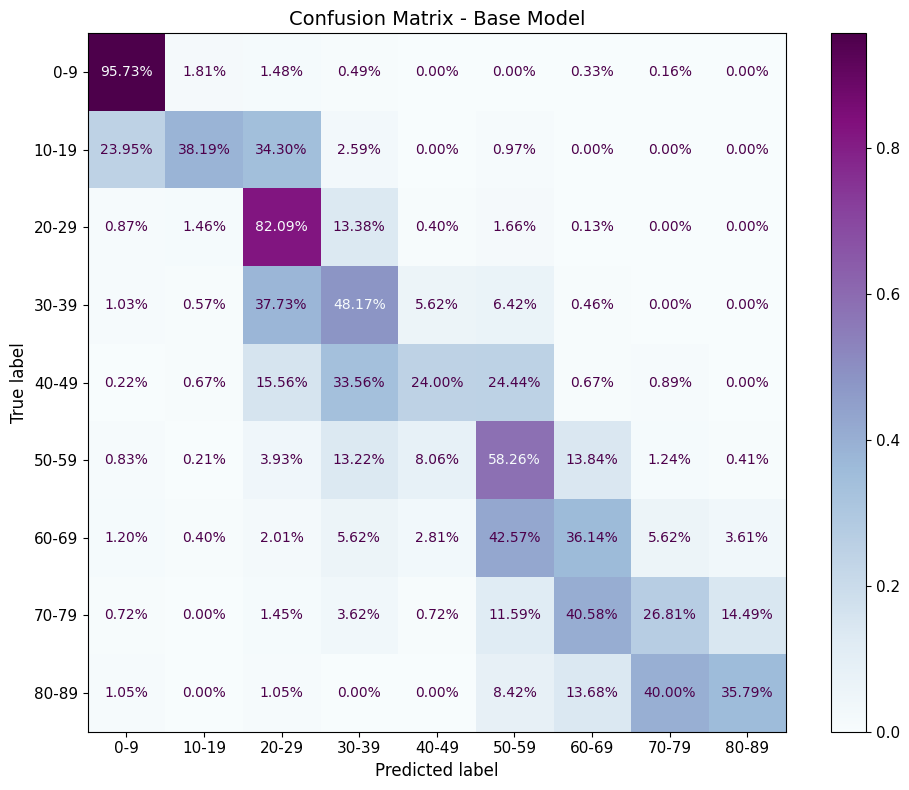

In [129]:
plot_confusion_matrix(df_base_results, 'Confusion Matrix - Base Model')

[[8.85057471e-01 9.68801314e-02 9.85221675e-03 0.00000000e+00
  3.28407225e-03 1.64203612e-03 3.28407225e-03 0.00000000e+00
  0.00000000e+00]
 [7.11974110e-02 6.82847896e-01 1.97411003e-01 3.88349515e-02
  6.47249191e-03 0.00000000e+00 3.23624595e-03 0.00000000e+00
  0.00000000e+00]
 [1.33155792e-03 5.52596538e-02 6.72436751e-01 2.27696405e-01
  2.92942743e-02 1.13182423e-02 1.99733688e-03 0.00000000e+00
  6.65778961e-04]
 [2.29357798e-03 1.26146789e-02 2.58027523e-01 4.23165138e-01
  2.39678899e-01 5.84862385e-02 3.44036697e-03 2.29357798e-03
  0.00000000e+00]
 [0.00000000e+00 8.88888889e-03 5.55555556e-02 2.02222222e-01
  4.55555556e-01 2.48888889e-01 2.22222222e-02 4.44444444e-03
  2.22222222e-03]
 [0.00000000e+00 4.13223140e-03 4.13223140e-03 5.16528926e-02
  2.29338843e-01 5.02066116e-01 1.32231405e-01 6.40495868e-02
  1.23966942e-02]
 [0.00000000e+00 1.20481928e-02 4.01606426e-03 2.00803213e-02
  6.02409639e-02 3.77510040e-01 2.53012048e-01 2.08835341e-01
  6.42570281e-02]
 [0.00

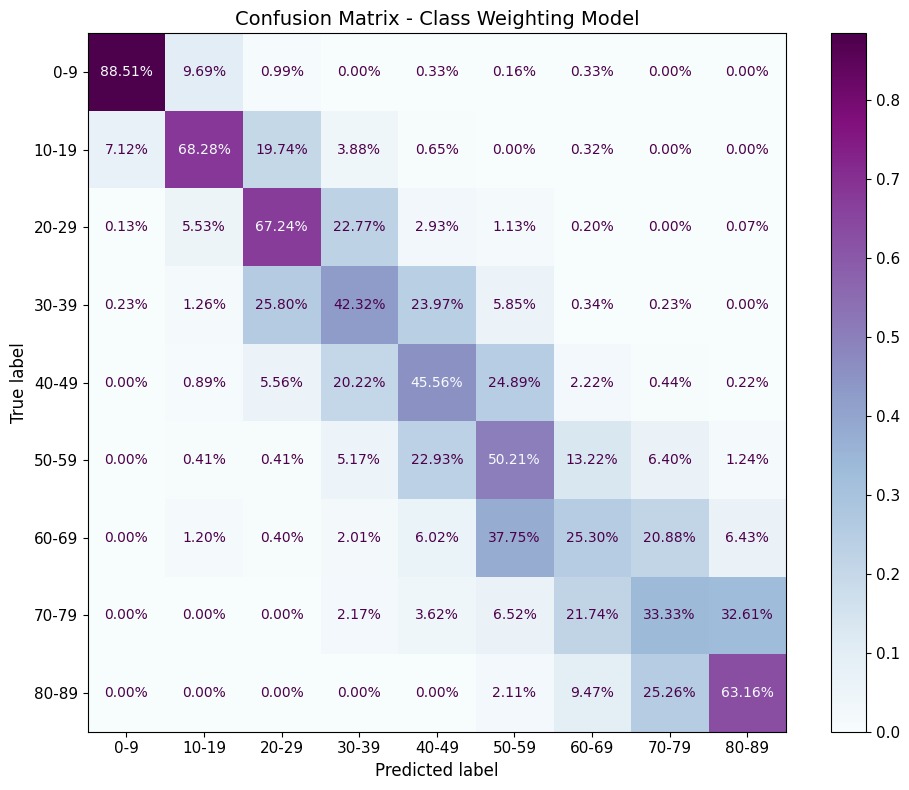

In [130]:
plot_confusion_matrix(df_balanced_results, 'Confusion Matrix - Class Weighting Model')

In [41]:
accuracy_base = calculate_accuracy_by_gender_and_ethnicity(df_base_results)
accuracy_balanced = calculate_accuracy_by_gender_and_ethnicity(df_balanced_results)

In [ ]:
base_mean = accuracy_base['Accuracy'].mean()
base_std = accuracy_base['Accuracy'].std()

balanced_mean = accuracy_balanced['Accuracy'].mean()
balanced_std = accuracy_balanced['Accuracy'].std()

print(f"Baseline Model - Mean Accuracy: {base_mean:.3f}, Std: {base_std:.3f}")
print(f"Class-Weighted Model - Mean Accuracy: {balanced_mean:.3f}, Std: {balanced_std:.3f}")

Baseline Model - Mean Accuracy: 0.657, Std: 0.008
Class-Weighted Model - Mean Accuracy: 0.616, Std: 0.007


Combined Accuracy by Gender and Ethnicity:
  Gender_Label Ethnicity_Label  Base Model  Class Weighting Model  Support
0         Male           White       0.541                  0.496     1109
1         Male           Black       0.581                  0.563      442
2         Male           Asian       0.713                  0.683      303
3         Male          Indian       0.608                  0.542      474
4         Male          Others       0.669                  0.607      145
5       Female           White       0.552                  0.562      924
6       Female           Black       0.624                  0.564      436
7       Female           Asian       0.794                  0.767      369
8       Female          Indian       0.706                  0.675      323
9       Female          Others       0.787                  0.705      183


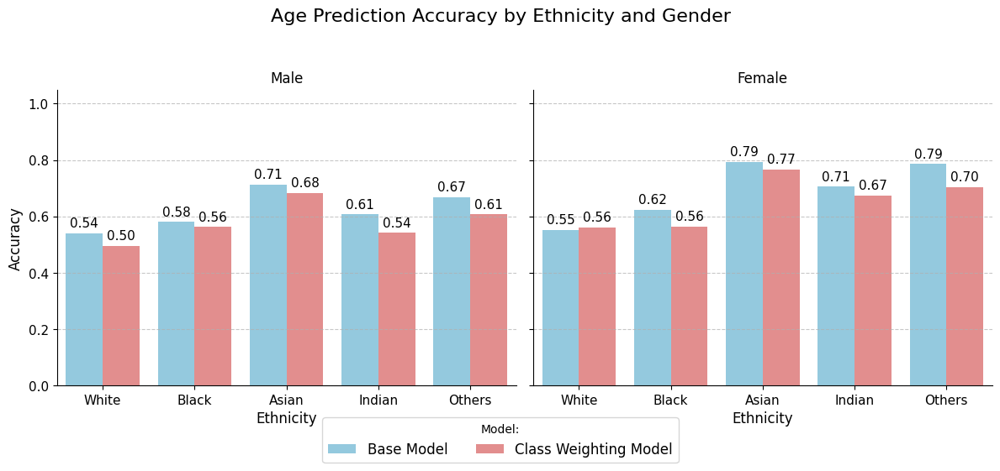

In [48]:
plot_accuracy_comparison_by_group(accuracy_base, accuracy_balanced)

Top 3 Predictions:
Age Range 0-9: 100.000% (0.9999996423721313)
Age Range 10-19: 0.000% (4.013499790289643e-07)
Age Range 20-29: 0.000% (7.015016345590652e-11)

Final Age Group Prediction:
Age Group: 0-9
Cumulative Confidence: 100.000% (0.9999996423721313)


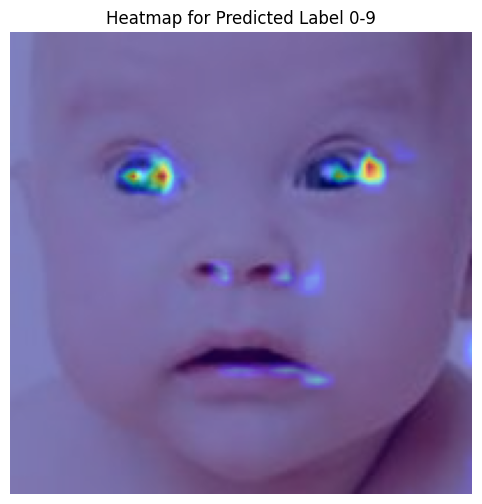

In [27]:
predict_xai(base_model, "datasets/utkface/1_0_0_20161219204759412.jpg.chip.jpg", plot_heatmap=True)

In [ ]:
gender_map = [0, 1]
ethnicity_map = [0, 1, 2, 3, 4]
age_group_map = [2, 4]

for gender in gender_map:
    for ethnicity in ethnicity_map:
        for age_group in age_group_map:
            find_prototype_and_criticism(df_balanced_results.copy(), gender, ethnicity, age_group, "balanced_model_prototypes_and_criticisms.csv", True)

INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/29_0_0_20170117190157234.jpg.chip.jpg
Age: 29
Age_Class: 20-29
Predicted_Age_Class: 20-29 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/29_0_0_20170117180920915.jpg.chip.jpg
Age: 29
Age_Class: 20-29
Predicted_Age_Class: 60-69 (Diff: 4)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 4 (40-49)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/44_0_0_20170105172858549.jpg.chip.jpg
Age: 44
Age_Class: 40-49
Predicted_Age_Class: 40-49 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/42_0_0_20170116205352497.jpg.chip.jpg
Age: 42
Age_Class: 40-49
Predicted_Age_Class: 80-89 (Diff: 4)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 1 (Black), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/24_0_1_20170113133945657.jpg.chip.jpg
Age: 24
Age_Class: 20-29
Predicted_Age_C

In [89]:
for gender in gender_map:
    for ethnicity in ethnicity_map:
        for age_group in age_group_map:
            find_prototype_and_criticism(df_base_results.copy(), gender, ethnicity, age_group, "base_model_prototypes_and_criticisms.csv", True)

INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/20_0_0_20170117134052589.jpg.chip.jpg
Age: 20
Age_Class: 20-29
Predicted_Age_Class: 20-29 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/26_0_0_20170117003329930.jpg.chip.jpg
Age: 26
Age_Class: 20-29
Predicted_Age_Class: 50-59 (Diff: 3)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 0 (White), Age_Class (Ground Truth): 4 (40-49)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/45_0_0_20170117185253753.jpg.chip.jpg
Age: 45
Age_Class: 40-49
Predicted_Age_Class: 40-49 (Diff: 0)

CRITICISM SAMPLE:
Image Path: datasets/utkface/42_0_0_20170116221906957.jpg.chip.jpg
Age: 42
Age_Class: 40-49
Predicted_Age_Class: 70-79 (Diff: 3)
INPUT PARAMETERS:
Gender: 0 (Male), Ethnicity: 1 (Black), Age_Class (Ground Truth): 2 (20-29)

PROTOTYPE SAMPLE:
Image Path: datasets/utkface/27_0_1_20170113133630265.jpg.chip.jpg
Age: 27
Age_Class: 20-29
Predicted_Age_C

Top 3 Predictions:
Age Range 0-9: 100.00% (0.9999996)
Age Range 10-19: 0.00% (0.0000004)
Age Range 20-29: 0.00% (0.0000000)

Final Age Group Prediction:
Age Group: 0-9
Cumulative Confidence: 100.00% (0.9999996)


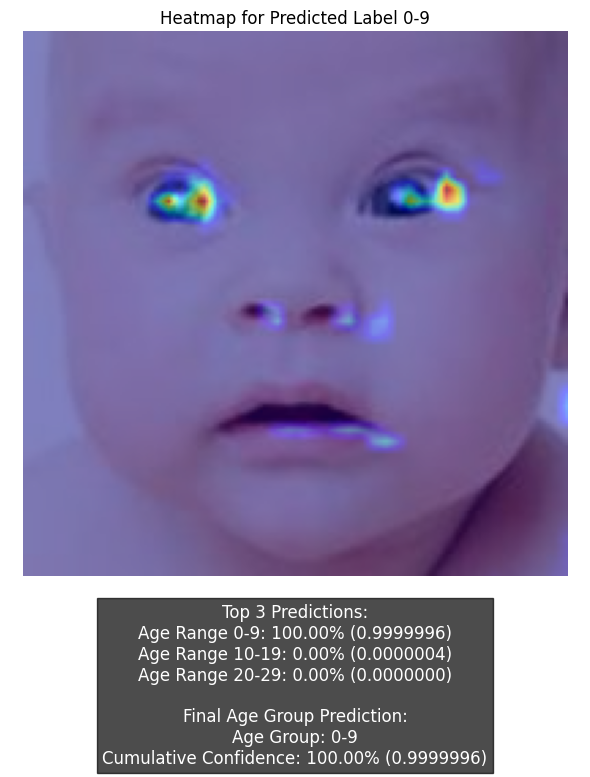

In [62]:
predict_xai(base_model, "datasets/utkface/1_0_0_20161219204759412.jpg.chip.jpg", plot_heatmap=True, save_file="images/test_heatmap_output.jpg")

Top 3 Predictions:
Age Range 20-29: 97.00% (0.9700425)
Age Range 30-39: 2.03% (0.0202694)
Age Range 10-19: 0.93% (0.0093399)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.00% (0.9700425)


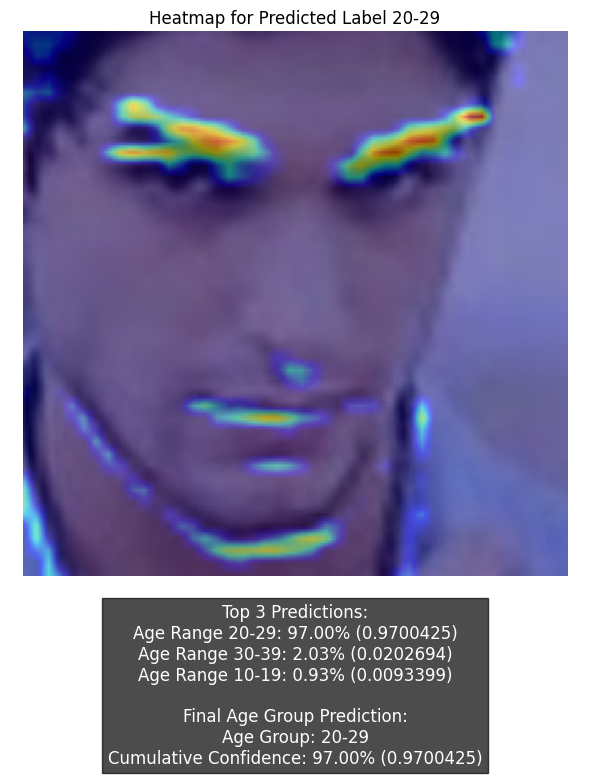

Top 3 Predictions:
Age Range 50-59: 21.58% (0.2157646)
Age Range 60-69: 20.73% (0.2073438)
Age Range 70-79: 17.10% (0.1710249)

Final Age Group Prediction:
Age Group: 20-89
Cumulative Confidence: 93.37% (0.9337090)


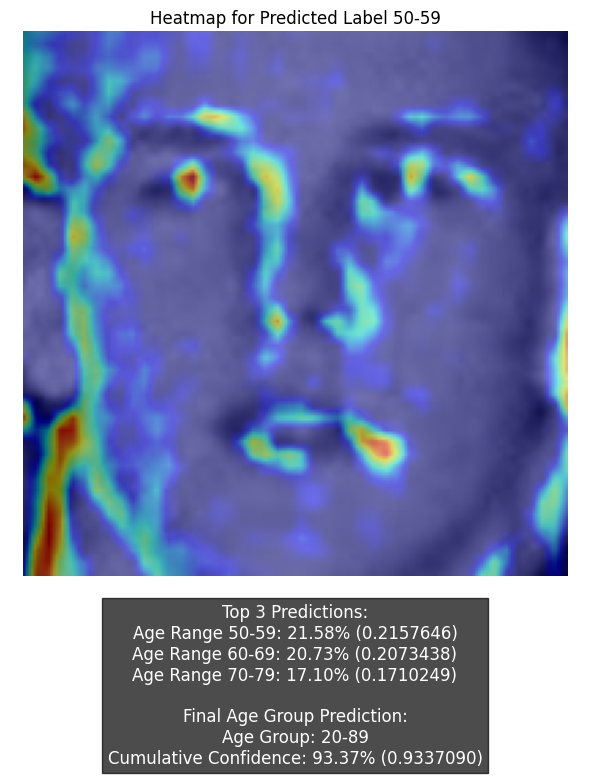

Top 3 Predictions:
Age Range 40-49: 58.73% (0.5873397)
Age Range 30-39: 25.95% (0.2595237)
Age Range 50-59: 14.32% (0.1431724)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 99.00% (0.9900358)


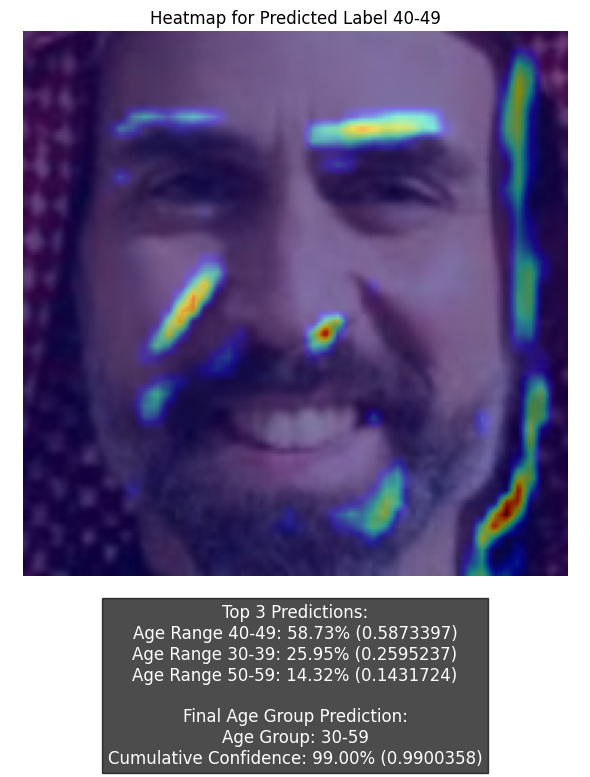

Top 3 Predictions:
Age Range 70-79: 28.51% (0.2851087)
Age Range 60-69: 26.31% (0.2631103)
Age Range 80-89: 20.66% (0.2065908)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 91.03% (0.9103400)


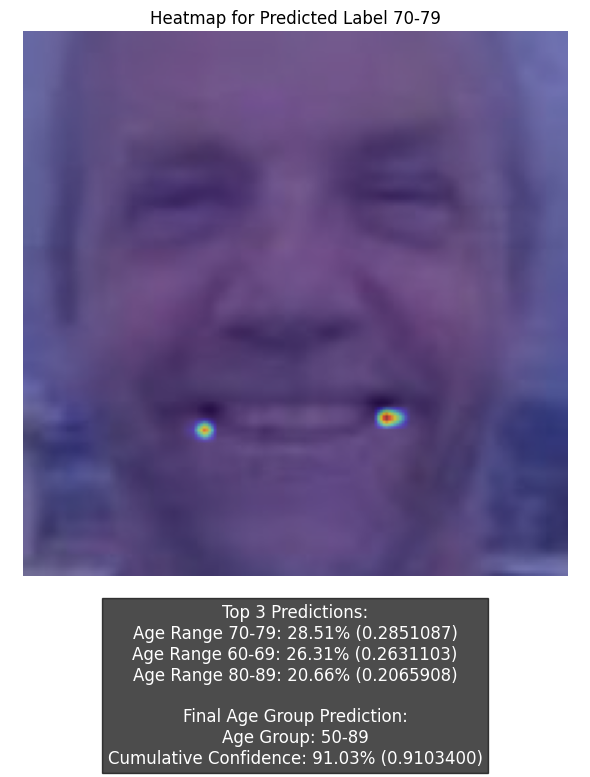

Top 3 Predictions:
Age Range 20-29: 92.59% (0.9258655)
Age Range 30-39: 5.95% (0.0594747)
Age Range 10-19: 1.38% (0.0137695)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 92.59% (0.9258655)


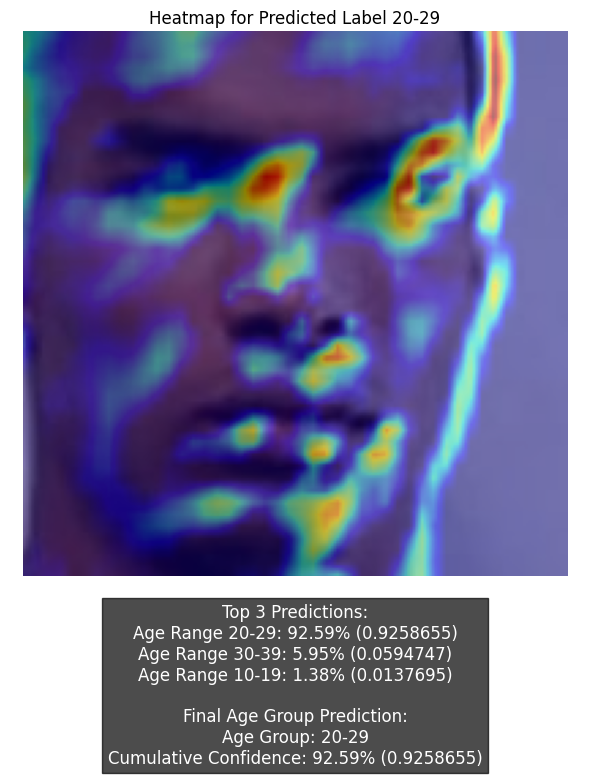

Top 3 Predictions:
Age Range 50-59: 28.64% (0.2864307)
Age Range 40-49: 15.93% (0.1593461)
Age Range 60-69: 15.23% (0.1522913)

Final Age Group Prediction:
Age Group: 10-89
Cumulative Confidence: 93.08% (0.9308338)


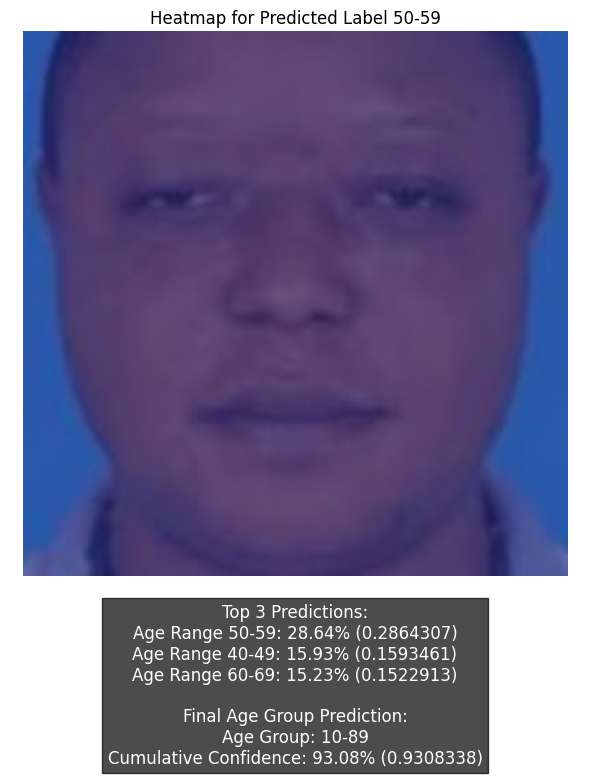

Top 3 Predictions:
Age Range 40-49: 44.47% (0.4446985)
Age Range 30-39: 31.18% (0.3117725)
Age Range 50-59: 16.49% (0.1648906)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 92.14% (0.9213616)


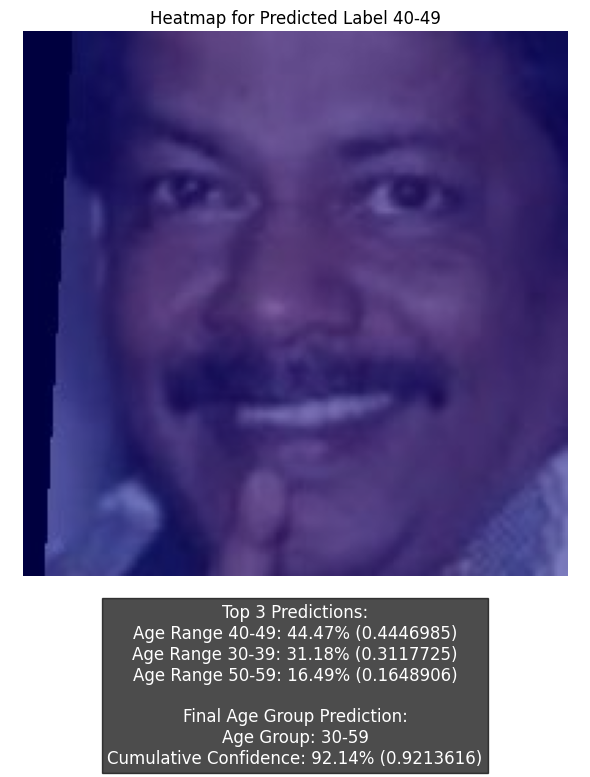

Top 3 Predictions:
Age Range 70-79: 28.10% (0.2809525)
Age Range 80-89: 27.83% (0.2783314)
Age Range 60-69: 24.17% (0.2417304)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 93.14% (0.9313764)


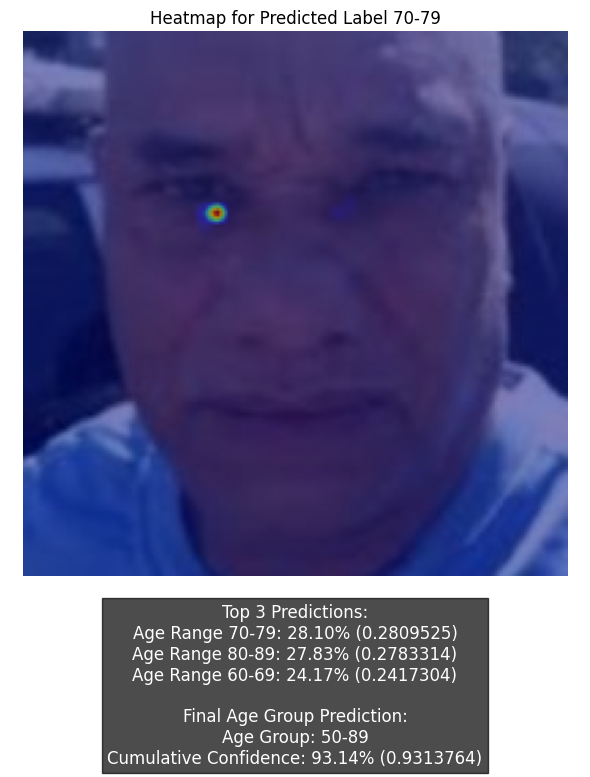

Top 3 Predictions:
Age Range 20-29: 97.63% (0.9762906)
Age Range 30-39: 2.14% (0.0214403)
Age Range 10-19: 0.21% (0.0020560)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.63% (0.9762906)


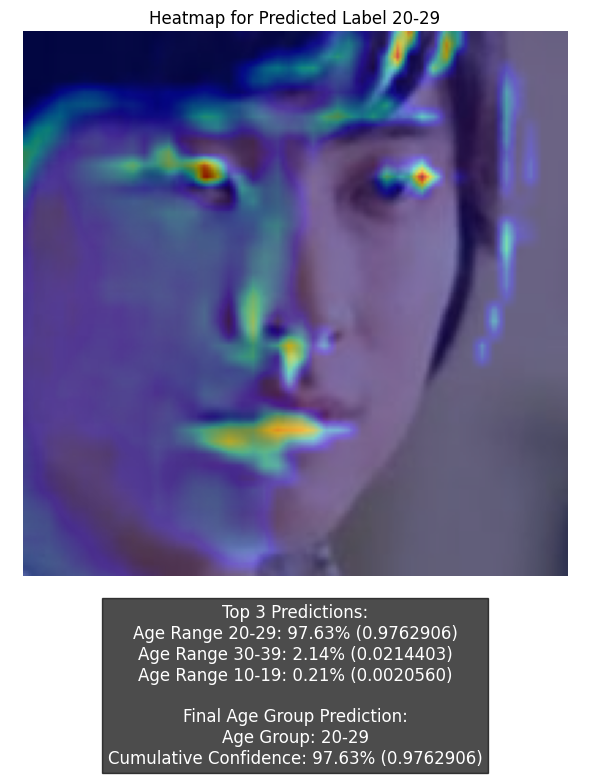

Top 3 Predictions:
Age Range 50-59: 28.01% (0.2800884)
Age Range 30-39: 17.96% (0.1795672)
Age Range 60-69: 15.20% (0.1520066)

Final Age Group Prediction:
Age Group: 20-79
Cumulative Confidence: 94.84% (0.9484479)


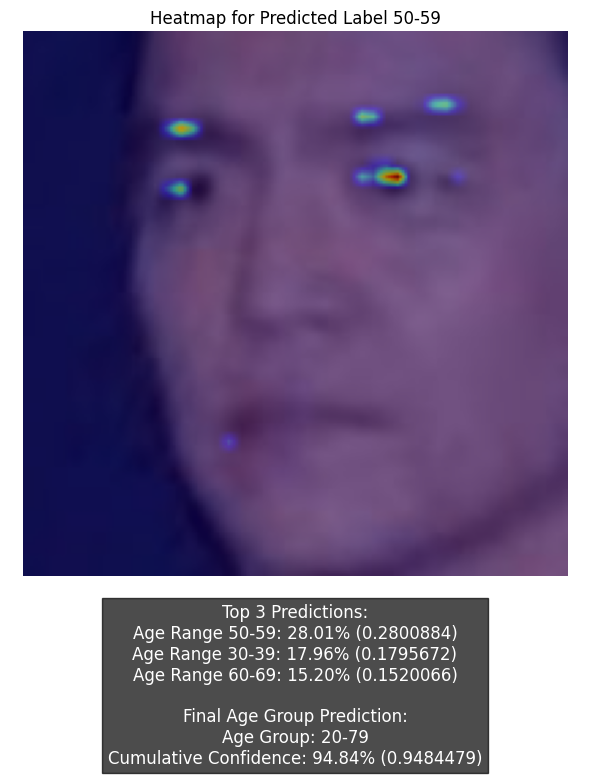

Top 3 Predictions:
Age Range 40-49: 41.17% (0.4116500)
Age Range 50-59: 32.33% (0.3232611)
Age Range 30-39: 19.76% (0.1976384)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 93.25% (0.9325495)


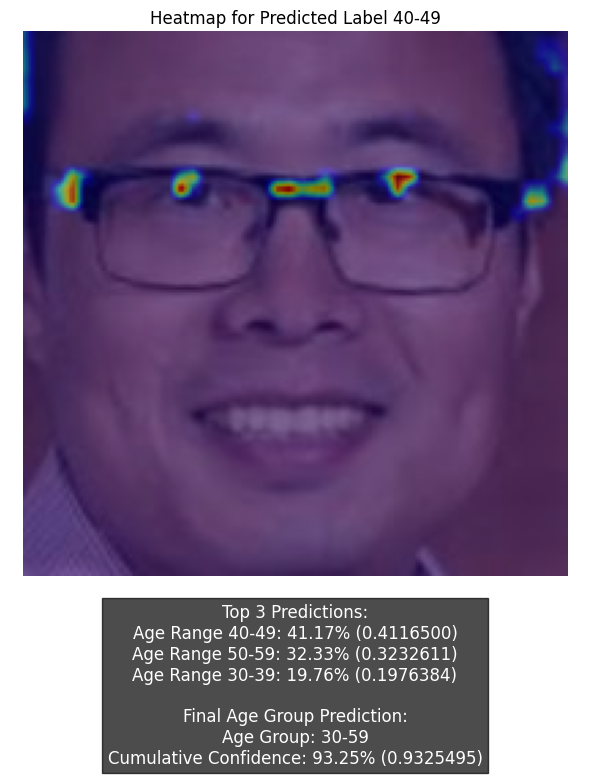

Top 3 Predictions:
Age Range 50-59: 16.30% (0.1630305)
Age Range 70-79: 14.95% (0.1494938)
Age Range 60-69: 14.89% (0.1489008)

Final Age Group Prediction:
Age Group: 0-89
Cumulative Confidence: 95.14% (0.9514132)


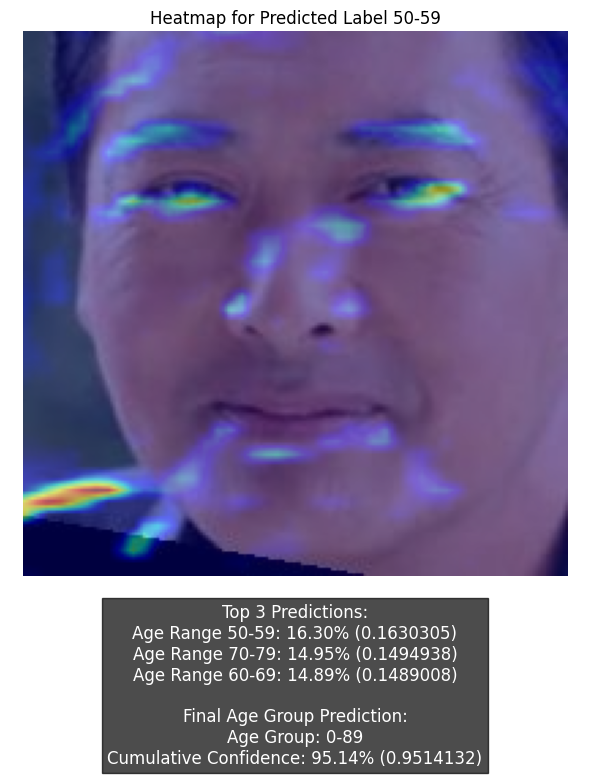

Top 3 Predictions:
Age Range 20-29: 99.38% (0.9938210)
Age Range 30-39: 0.58% (0.0058290)
Age Range 10-19: 0.03% (0.0003182)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 99.38% (0.9938210)


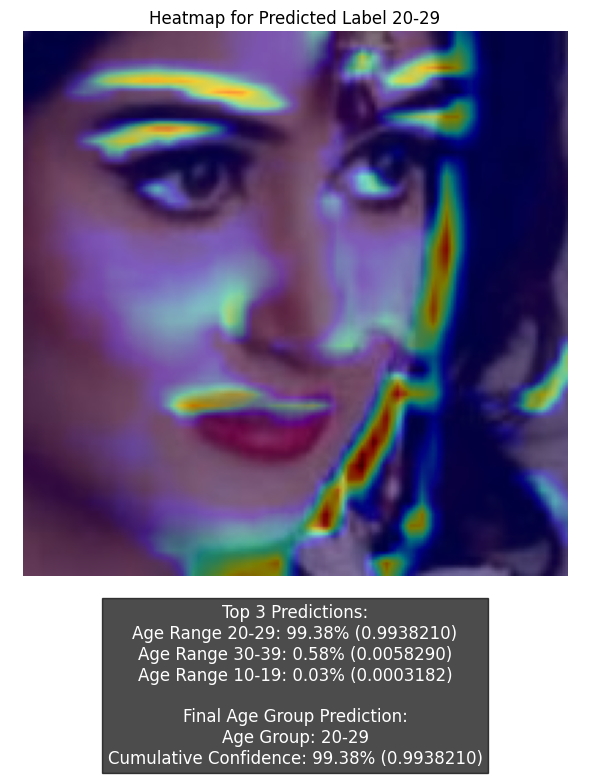

Top 3 Predictions:
Age Range 50-59: 40.24% (0.4023744)
Age Range 40-49: 18.30% (0.1829727)
Age Range 60-69: 17.96% (0.1795696)

Final Age Group Prediction:
Age Group: 30-79
Cumulative Confidence: 92.88% (0.9288296)


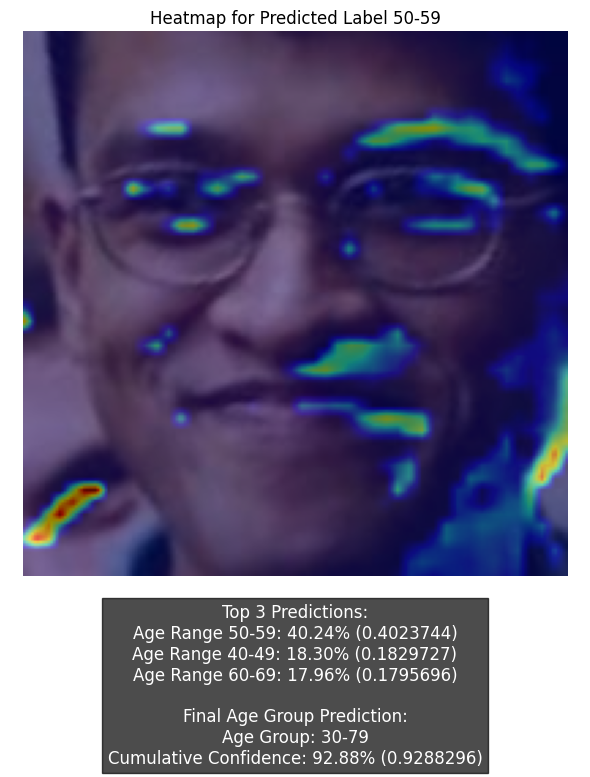

Top 3 Predictions:
Age Range 40-49: 55.49% (0.5549141)
Age Range 50-59: 21.92% (0.2191858)
Age Range 30-39: 20.76% (0.2075914)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.17% (0.9816913)


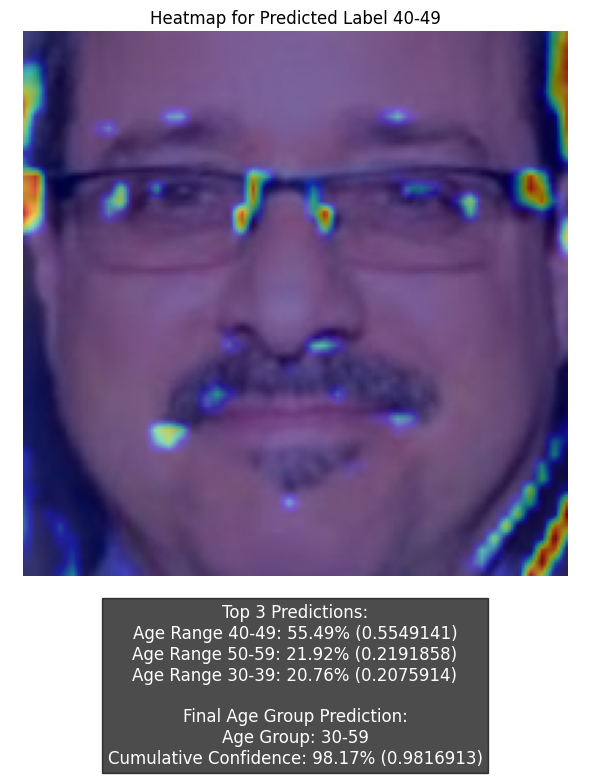

Top 3 Predictions:
Age Range 50-59: 42.54% (0.4253563)
Age Range 40-49: 38.26% (0.3826408)
Age Range 30-39: 13.09% (0.1308638)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 93.89% (0.9388610)


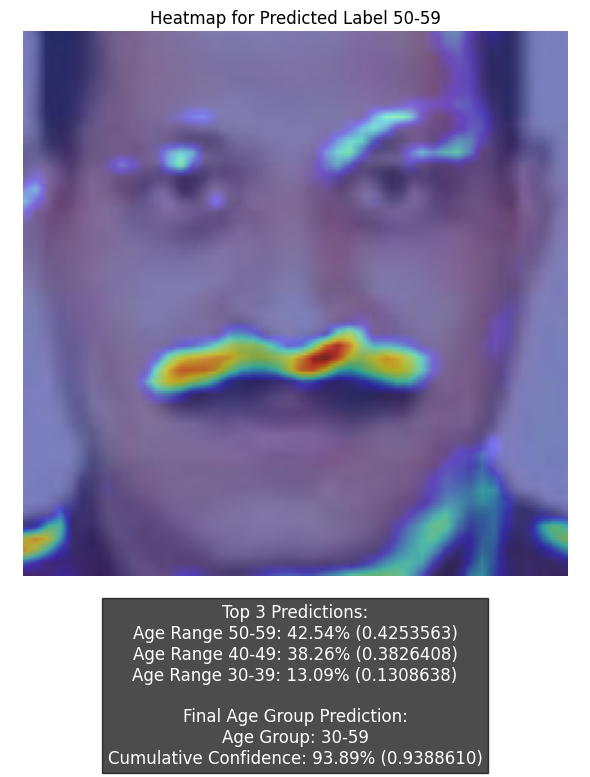

Top 3 Predictions:
Age Range 20-29: 94.09% (0.9408589)
Age Range 30-39: 4.48% (0.0448085)
Age Range 10-19: 1.31% (0.0130655)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 94.09% (0.9408589)


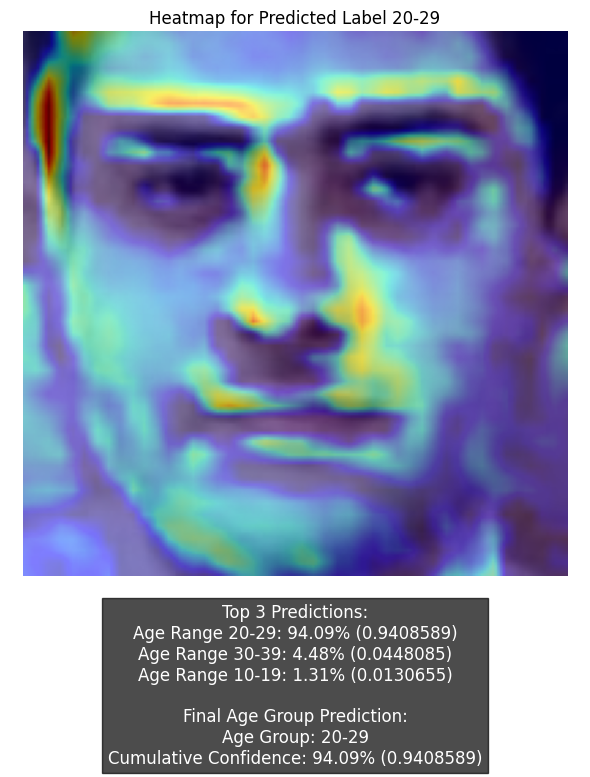

Top 3 Predictions:
Age Range 30-39: 65.18% (0.6517762)
Age Range 40-49: 21.20% (0.2119688)
Age Range 20-29: 11.66% (0.1165816)

Final Age Group Prediction:
Age Group: 20-49
Cumulative Confidence: 98.03% (0.9803266)


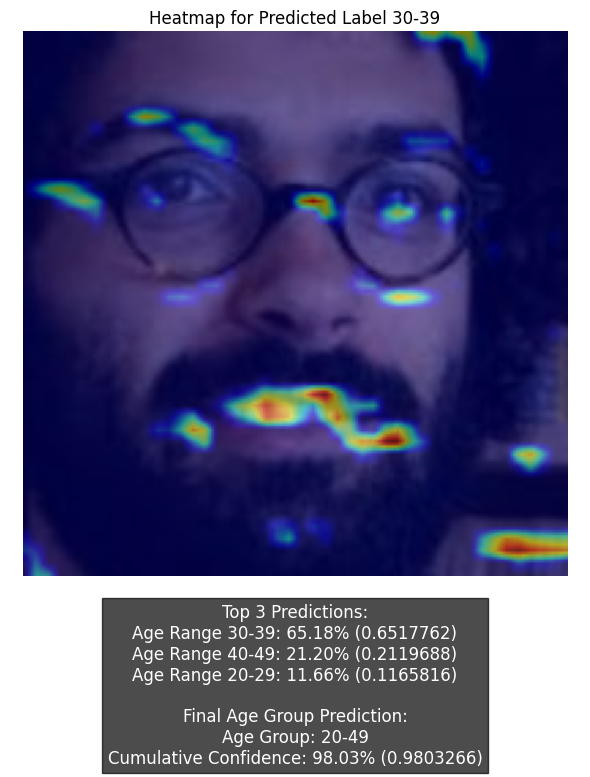

Top 3 Predictions:
Age Range 40-49: 55.33% (0.5533218)
Age Range 50-59: 21.75% (0.2174988)
Age Range 30-39: 21.03% (0.2103355)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.12% (0.9811561)


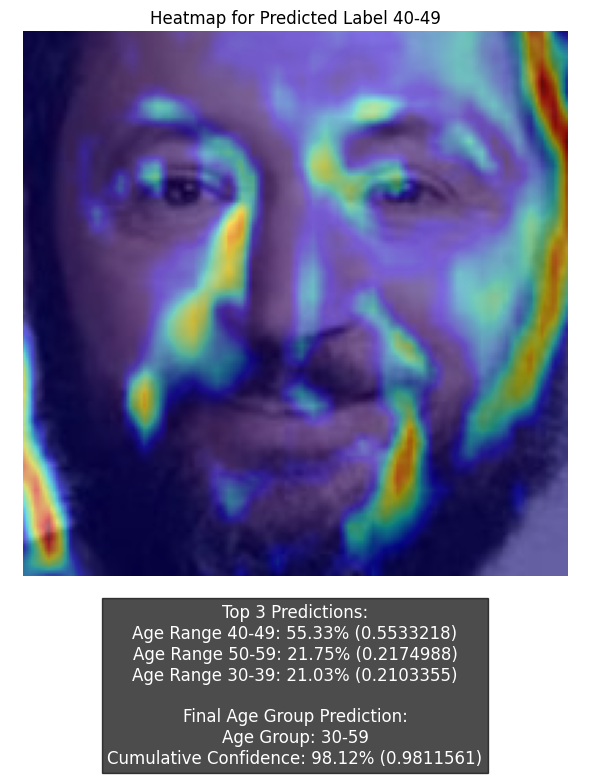

Top 3 Predictions:
Age Range 50-59: 44.69% (0.4468674)
Age Range 40-49: 31.99% (0.3198826)
Age Range 60-69: 9.78% (0.0977690)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 96.19% (0.9619009)


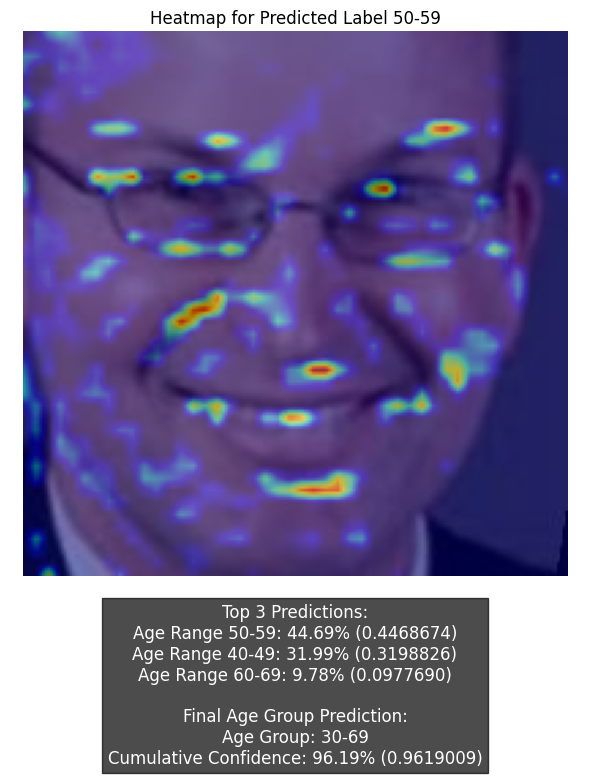

Top 3 Predictions:
Age Range 20-29: 98.18% (0.9817525)
Age Range 30-39: 1.46% (0.0146088)
Age Range 10-19: 0.32% (0.0032303)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.18% (0.9817525)


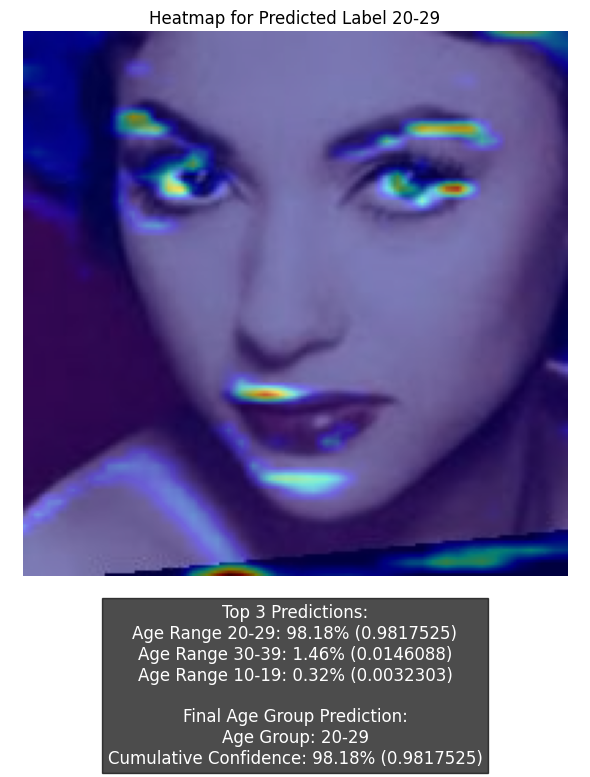

Top 3 Predictions:
Age Range 60-69: 34.56% (0.3456427)
Age Range 50-59: 33.25% (0.3325167)
Age Range 70-79: 17.60% (0.1760327)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 92.18% (0.9217801)


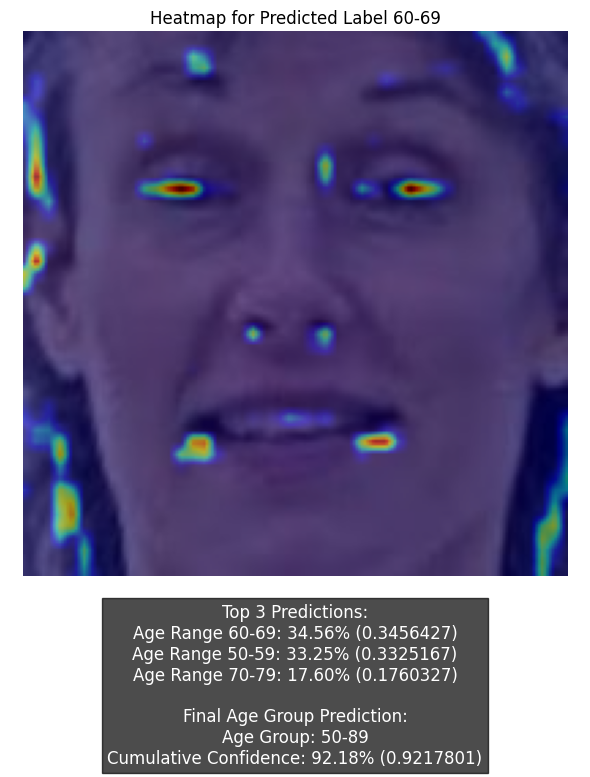

Top 3 Predictions:
Age Range 40-49: 49.58% (0.4957998)
Age Range 30-39: 37.59% (0.3758735)
Age Range 50-59: 9.11% (0.0911065)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.28% (0.9627798)


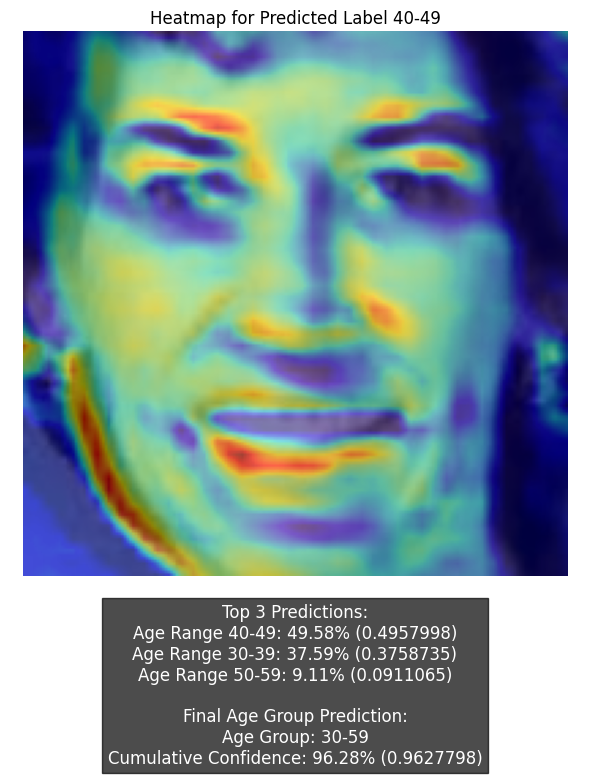

Top 3 Predictions:
Age Range 60-69: 32.12% (0.3212177)
Age Range 70-79: 27.17% (0.2717118)
Age Range 80-89: 17.66% (0.1766416)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 93.35% (0.9334702)


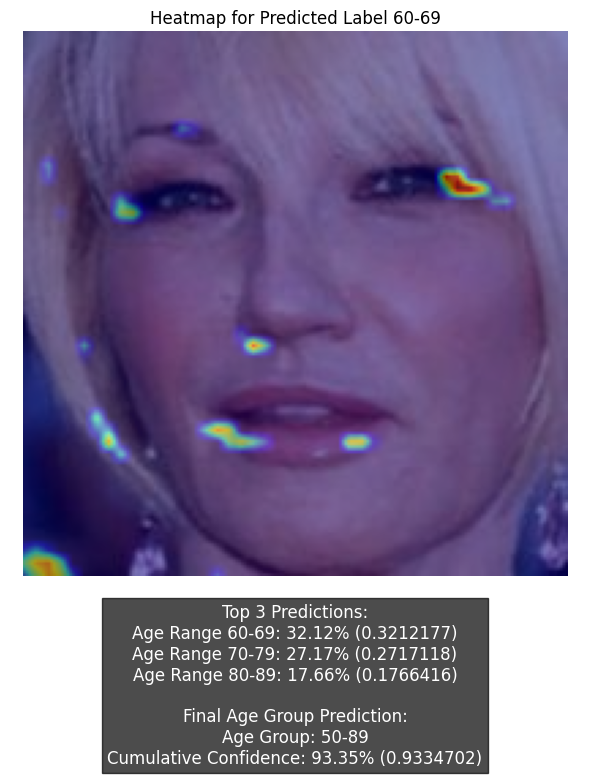

Top 3 Predictions:
Age Range 20-29: 95.49% (0.9548954)
Age Range 30-39: 4.29% (0.0429217)
Age Range 10-19: 0.18% (0.0017954)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 95.49% (0.9548954)


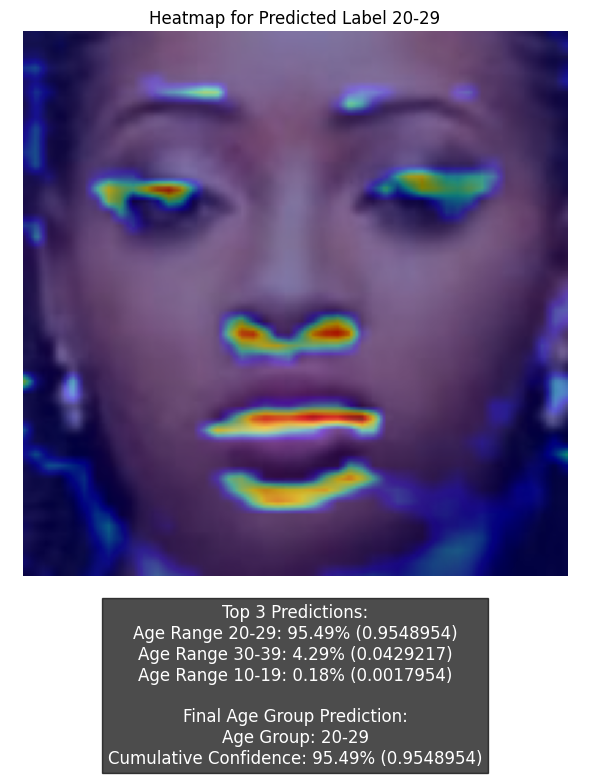

Top 3 Predictions:
Age Range 50-59: 22.78% (0.2278037)
Age Range 20-29: 18.88% (0.1887822)
Age Range 30-39: 18.54% (0.1853957)

Final Age Group Prediction:
Age Group: 20-79
Cumulative Confidence: 93.16% (0.9316235)


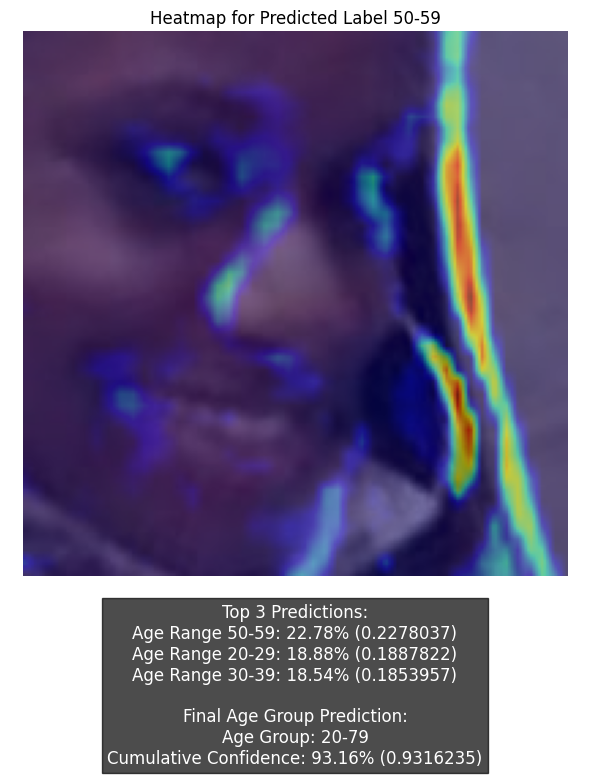

Top 3 Predictions:
Age Range 40-49: 39.99% (0.3998877)
Age Range 50-59: 30.46% (0.3045969)
Age Range 30-39: 20.07% (0.2007470)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 90.52% (0.9052316)


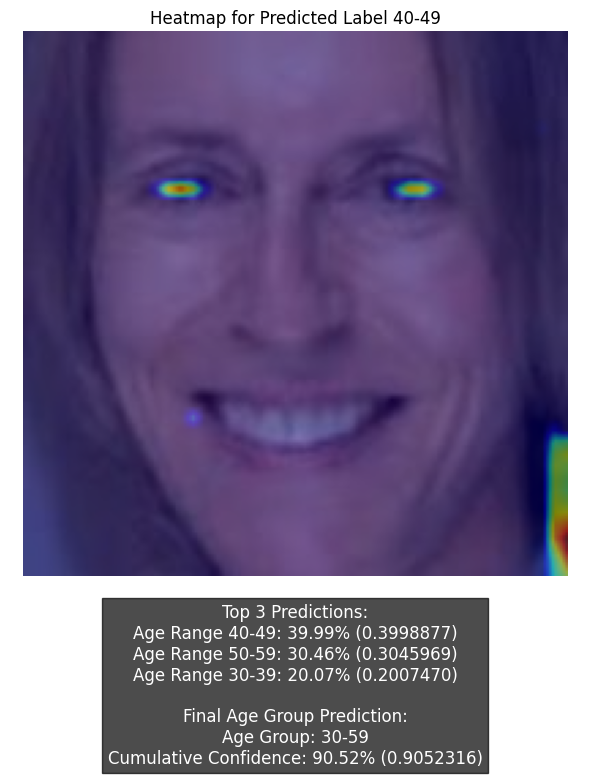

Top 3 Predictions:
Age Range 50-59: 37.02% (0.3701879)
Age Range 40-49: 34.97% (0.3496758)
Age Range 30-39: 21.00% (0.2100344)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 92.99% (0.9298981)


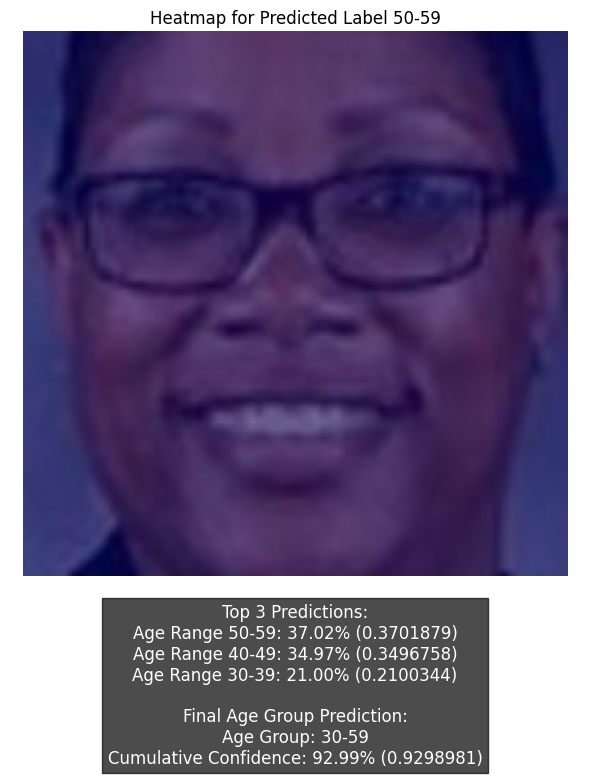

Top 3 Predictions:
Age Range 20-29: 98.62% (0.9862244)
Age Range 30-39: 1.04% (0.0103874)
Age Range 10-19: 0.32% (0.0032034)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 98.62% (0.9862244)


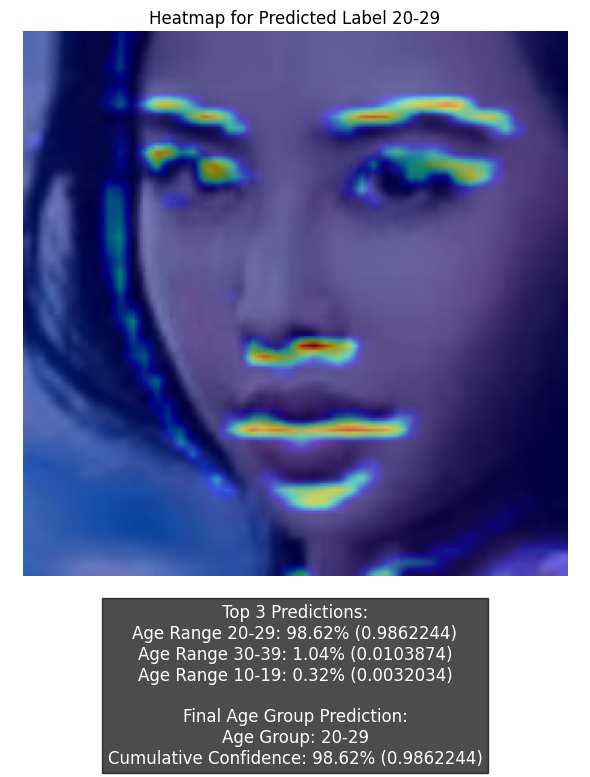

Top 3 Predictions:
Age Range 60-69: 16.31% (0.1630892)
Age Range 50-59: 15.48% (0.1547986)
Age Range 70-79: 14.40% (0.1440473)

Final Age Group Prediction:
Age Group: 10-89
Cumulative Confidence: 93.37% (0.9337306)


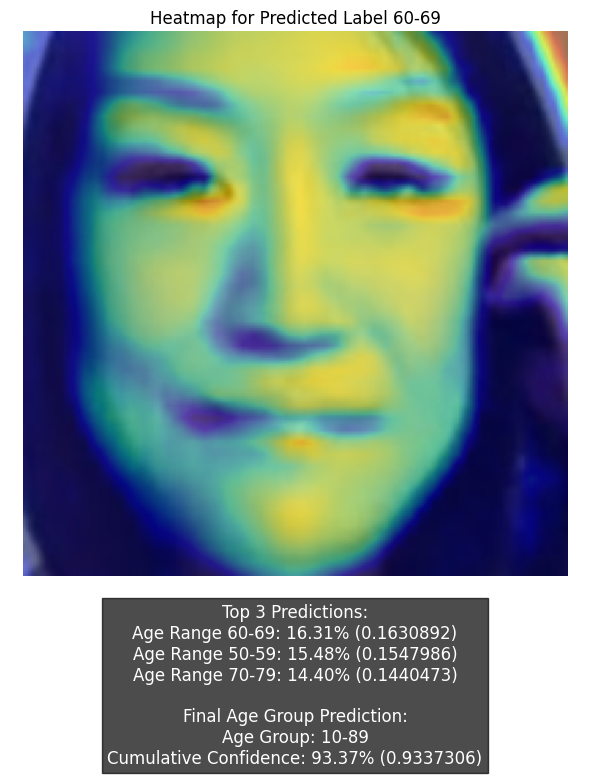

Top 3 Predictions:
Age Range 20-29: 18.06% (0.1806473)
Age Range 30-39: 16.40% (0.1639667)
Age Range 40-49: 14.04% (0.1404123)

Final Age Group Prediction:
Age Group: 0-69
Cumulative Confidence: 90.75% (0.9074871)


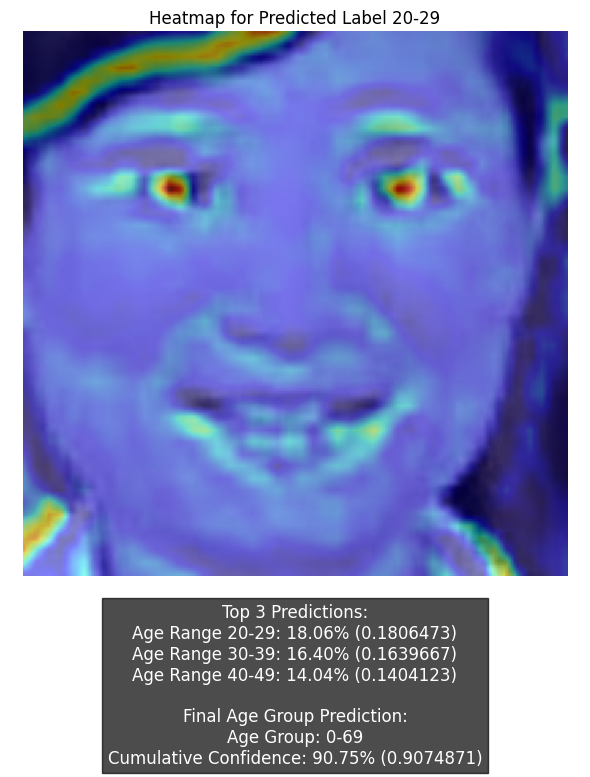

Top 3 Predictions:
Age Range 50-59: 29.58% (0.2957996)
Age Range 60-69: 22.10% (0.2209803)
Age Range 40-49: 15.76% (0.1576366)

Final Age Group Prediction:
Age Group: 30-89
Cumulative Confidence: 95.36% (0.9536448)


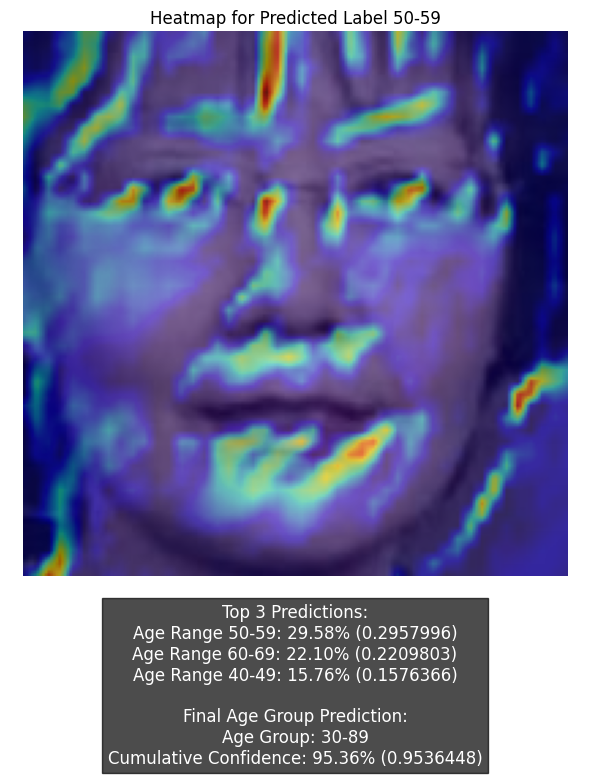

Top 3 Predictions:
Age Range 20-29: 97.82% (0.9781612)
Age Range 30-39: 2.12% (0.0212244)
Age Range 10-19: 0.05% (0.0004661)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 97.82% (0.9781612)


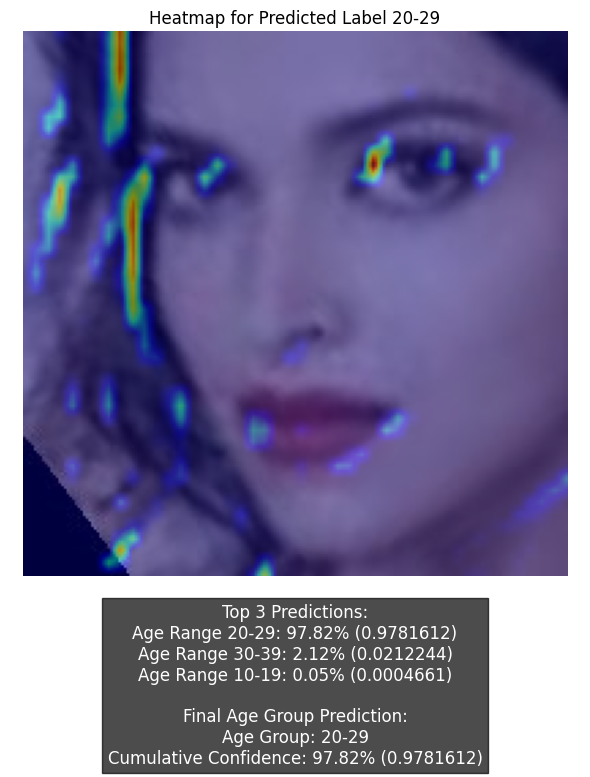

Top 3 Predictions:
Age Range 40-49: 33.38% (0.3338129)
Age Range 50-59: 27.66% (0.2765782)
Age Range 30-39: 25.66% (0.2565723)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 92.58% (0.9257584)


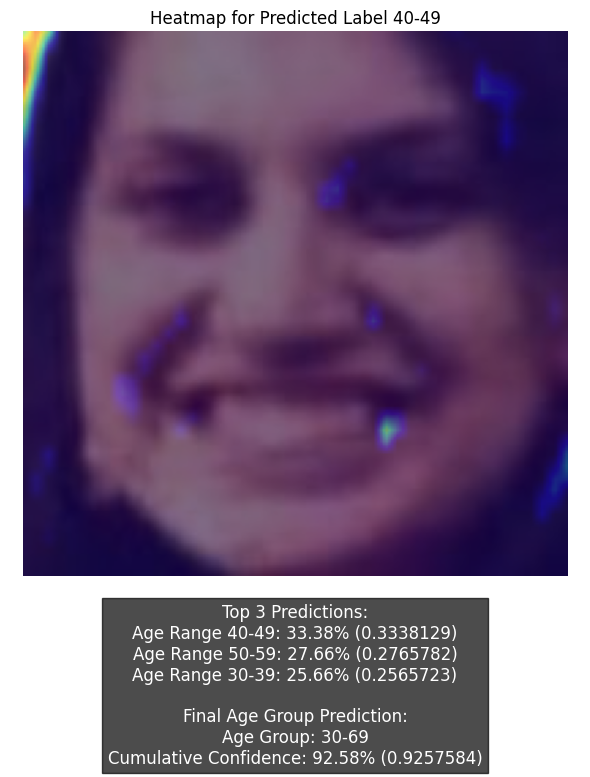

Top 3 Predictions:
Age Range 10-19: 72.79% (0.7278857)
Age Range 0-9: 16.92% (0.1691663)
Age Range 20-29: 6.56% (0.0655534)

Final Age Group Prediction:
Age Group: 0-29
Cumulative Confidence: 96.26% (0.9626054)


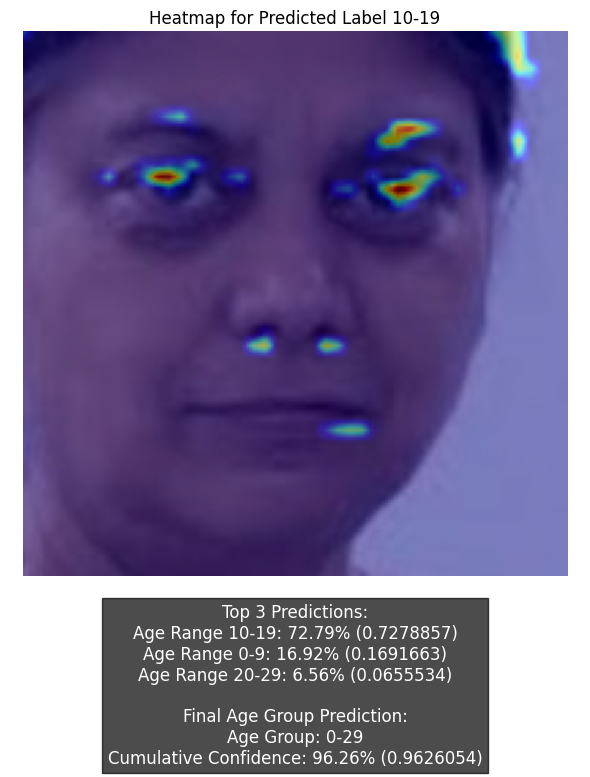

Top 3 Predictions:
Age Range 50-59: 31.64% (0.3164095)
Age Range 40-49: 28.80% (0.2879596)
Age Range 30-39: 20.34% (0.2034385)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 90.51% (0.9050552)


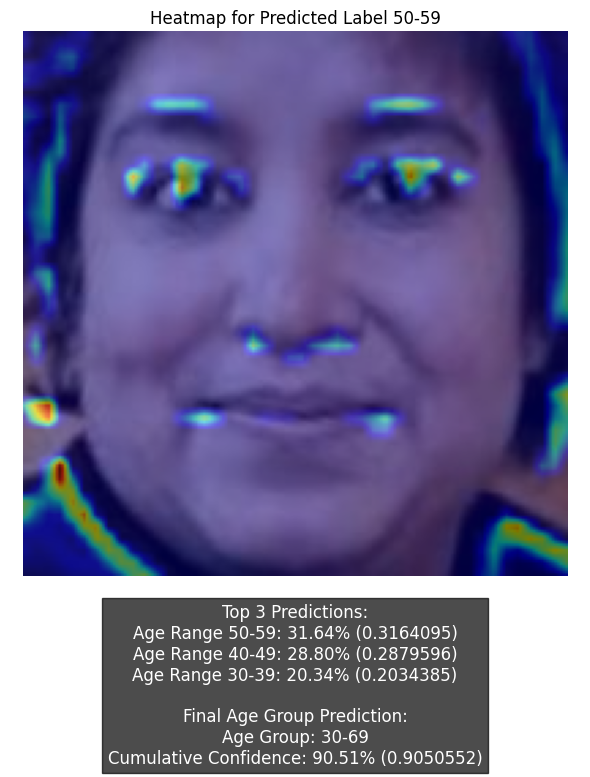

Top 3 Predictions:
Age Range 20-29: 95.88% (0.9587865)
Age Range 30-39: 4.01% (0.0400507)
Age Range 10-19: 0.09% (0.0009229)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 95.88% (0.9587865)


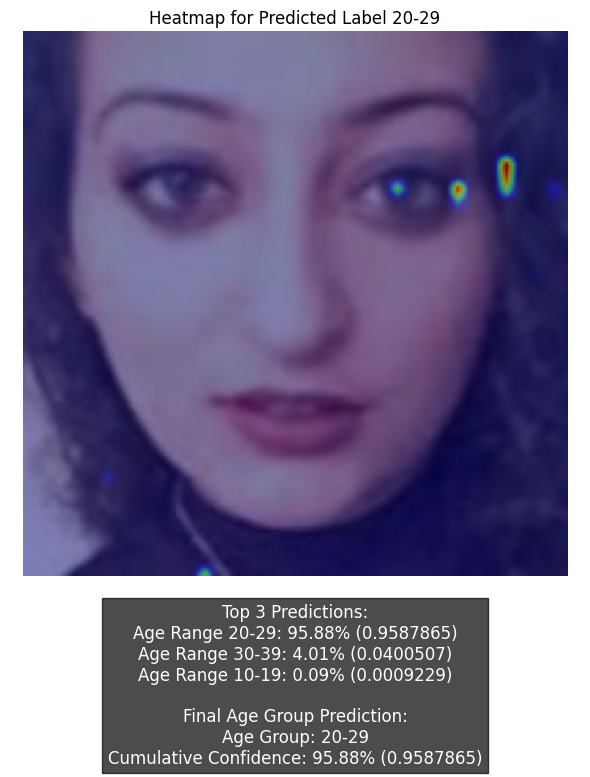

Top 3 Predictions:
Age Range 30-39: 33.89% (0.3389454)
Age Range 20-29: 20.11% (0.2011474)
Age Range 40-49: 19.79% (0.1979133)

Final Age Group Prediction:
Age Group: 20-69
Cumulative Confidence: 92.15% (0.9214905)


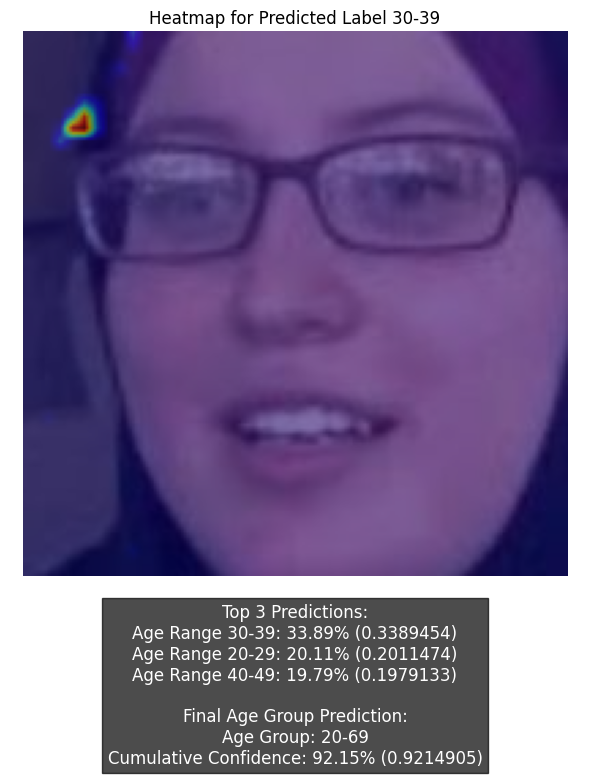

Top 3 Predictions:
Age Range 20-29: 61.32% (0.6132448)
Age Range 30-39: 31.01% (0.3101452)
Age Range 40-49: 3.80% (0.0380433)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 92.34% (0.9233899)


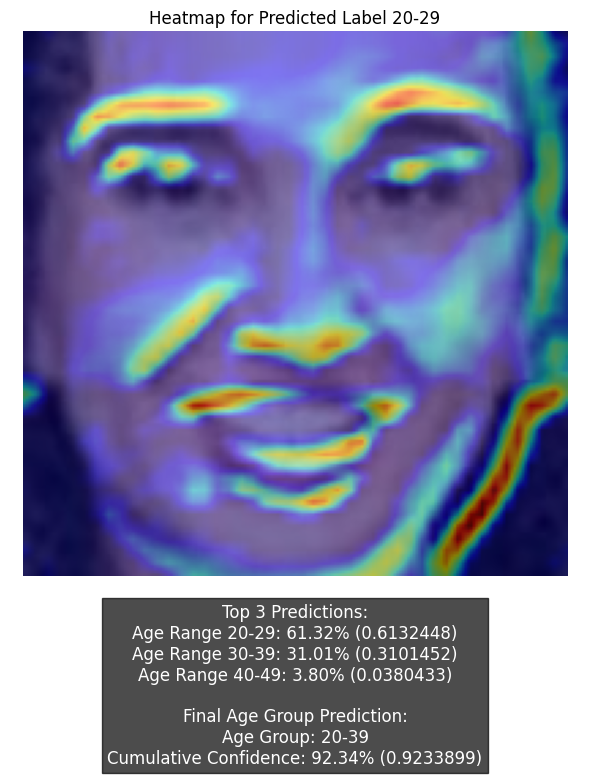

Top 3 Predictions:
Age Range 30-39: 35.52% (0.3551840)
Age Range 20-29: 29.89% (0.2989269)
Age Range 40-49: 14.69% (0.1469419)

Final Age Group Prediction:
Age Group: 10-59
Cumulative Confidence: 93.55% (0.9354835)


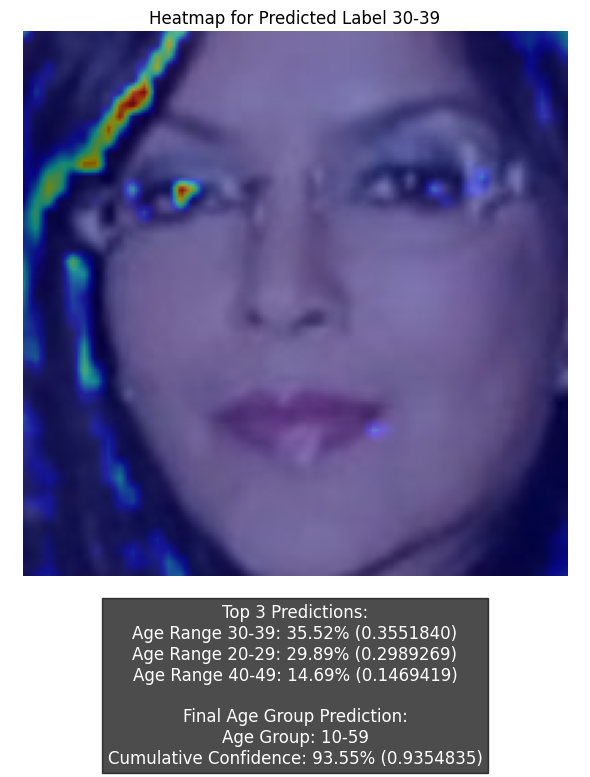

In [92]:
df_to_process = pd.read_csv('base_model_prototypes_and_criticisms.csv')

for index, row in df_to_process.iterrows():
    prototype_image_path = row['Prototype_Image_Path']
    criticism_image_path = row['Criticism_Image_Path']
    
    prototype_save_file = f"images/prototypes_and_criticisms/base_heatmap_prototype_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    criticism_save_file = f"images/prototypes_and_criticisms/base_heatmap_criticism_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    
    predict_xai(base_model, prototype_image_path, plot_heatmap=True, save_file=prototype_save_file)
    predict_xai(base_model, criticism_image_path, plot_heatmap=True, save_file=criticism_save_file)

Top 3 Predictions:
Age Range 20-29: 83.11% (0.8311025)
Age Range 30-39: 9.83% (0.0982997)
Age Range 10-19: 6.83% (0.0682808)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 92.94% (0.9294022)


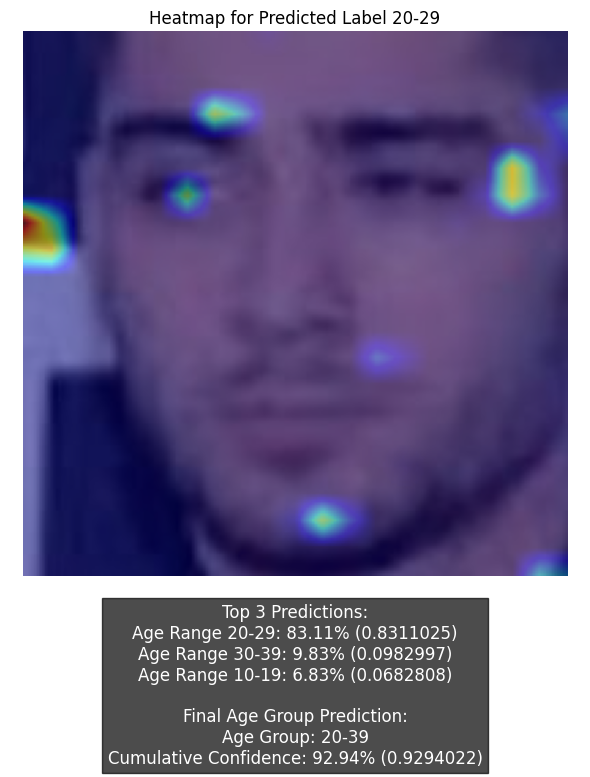

Top 3 Predictions:
Age Range 60-69: 29.33% (0.2933350)
Age Range 70-79: 27.95% (0.2795325)
Age Range 50-59: 20.31% (0.2031441)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 94.40% (0.9439979)


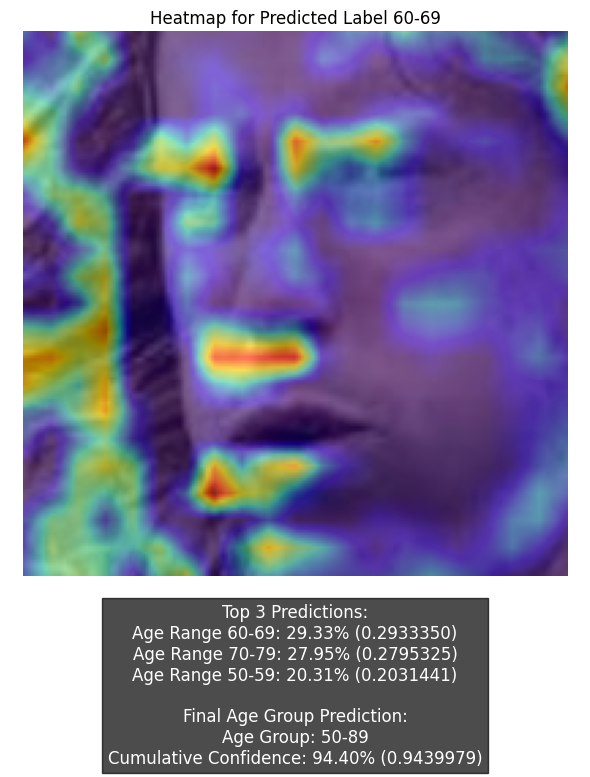

Top 3 Predictions:
Age Range 40-49: 73.75% (0.7374552)
Age Range 30-39: 18.78% (0.1878288)
Age Range 50-59: 6.69% (0.0668536)

Final Age Group Prediction:
Age Group: 30-49
Cumulative Confidence: 92.53% (0.9252840)


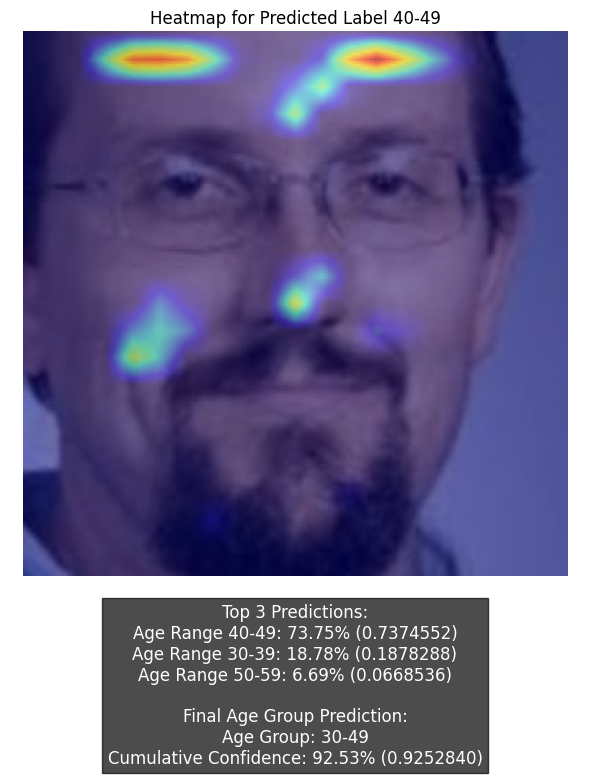

Top 3 Predictions:
Age Range 80-89: 36.59% (0.3658832)
Age Range 70-79: 33.14% (0.3313873)
Age Range 60-69: 21.90% (0.2190176)

Final Age Group Prediction:
Age Group: 60-89
Cumulative Confidence: 91.63% (0.9162881)


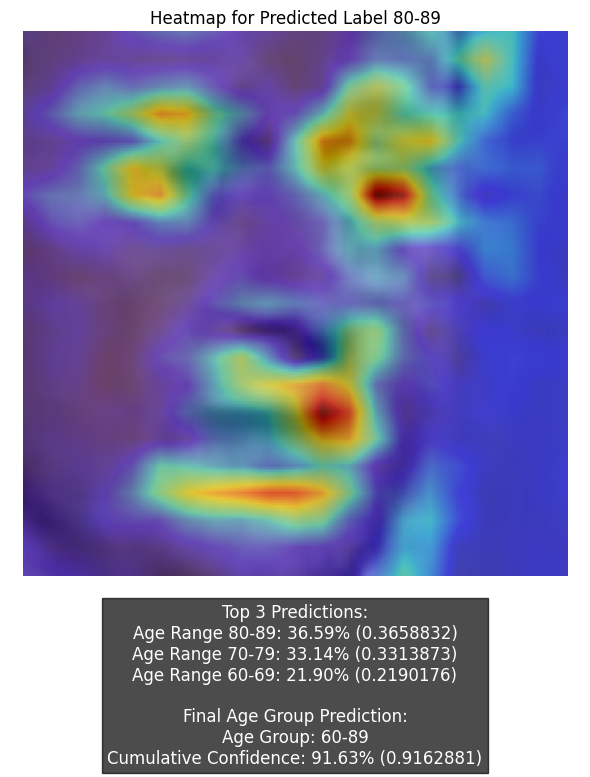

Top 3 Predictions:
Age Range 20-29: 85.46% (0.8545674)
Age Range 30-39: 12.04% (0.1204280)
Age Range 10-19: 2.38% (0.0237672)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 97.50% (0.9749954)


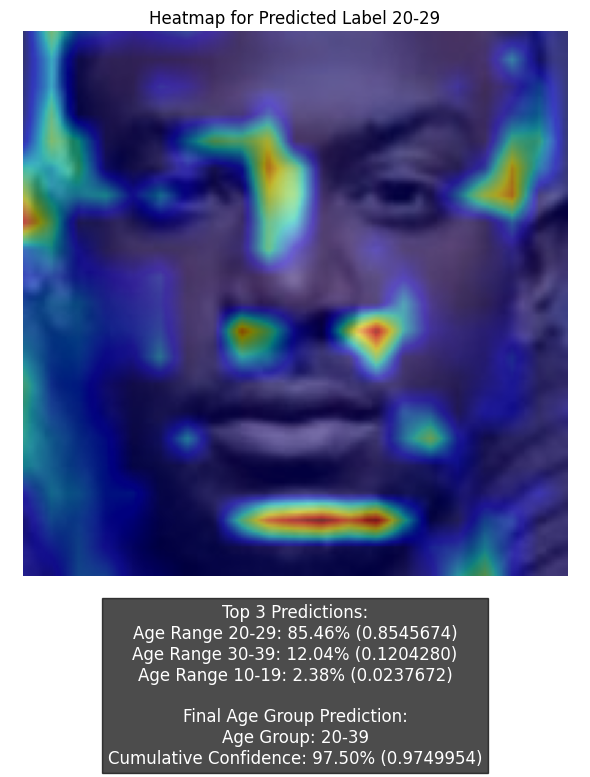

Top 3 Predictions:
Age Range 80-89: 34.56% (0.3455752)
Age Range 70-79: 33.81% (0.3381223)
Age Range 60-69: 22.14% (0.2213930)

Final Age Group Prediction:
Age Group: 60-89
Cumulative Confidence: 90.51% (0.9050906)


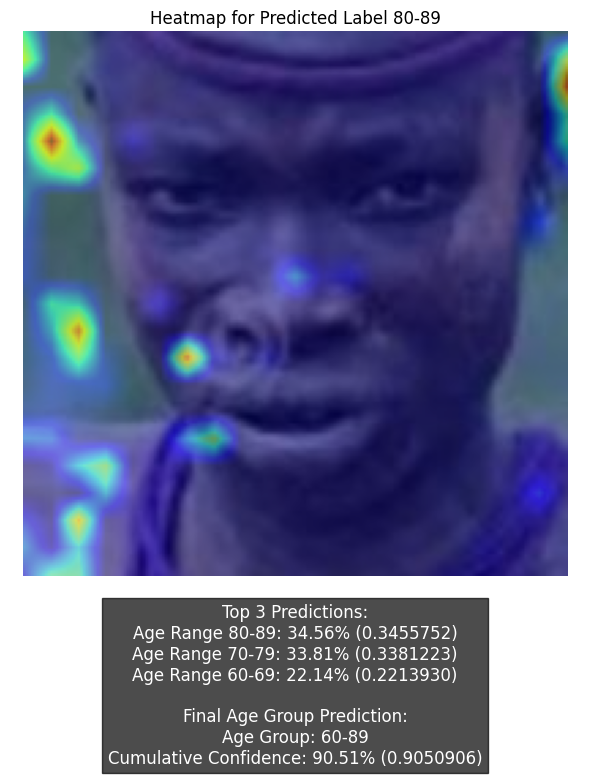

Top 3 Predictions:
Age Range 40-49: 62.60% (0.6260448)
Age Range 50-59: 23.17% (0.2316864)
Age Range 30-39: 11.59% (0.1158646)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 97.36% (0.9735957)


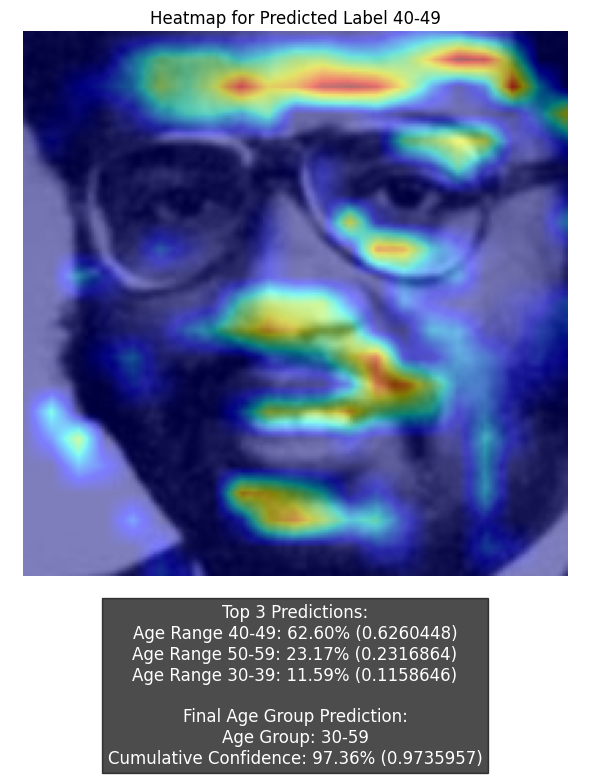

Top 3 Predictions:
Age Range 50-59: 46.08% (0.4608057)
Age Range 40-49: 29.29% (0.2929446)
Age Range 60-69: 17.12% (0.1711929)

Final Age Group Prediction:
Age Group: 40-69
Cumulative Confidence: 92.49% (0.9249431)


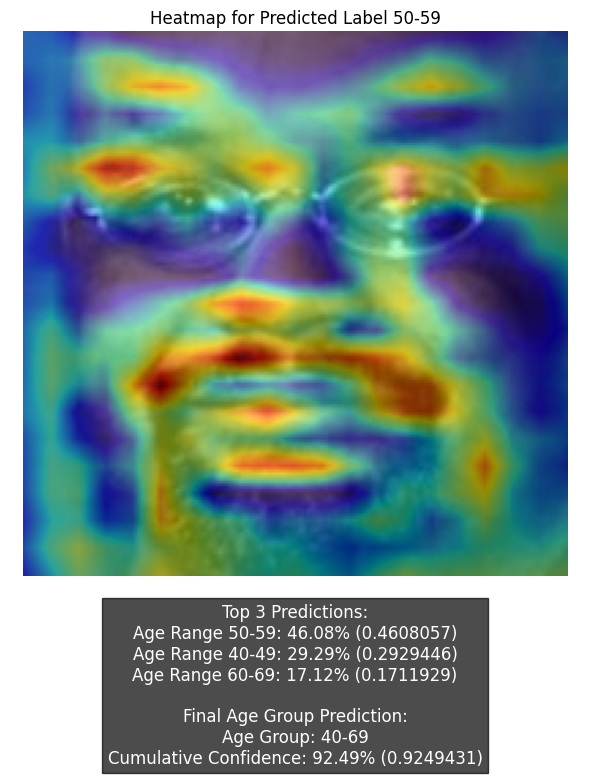

Top 3 Predictions:
Age Range 20-29: 83.37% (0.8336638)
Age Range 30-39: 15.45% (0.1544663)
Age Range 10-19: 0.68% (0.0068188)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 98.81% (0.9881301)


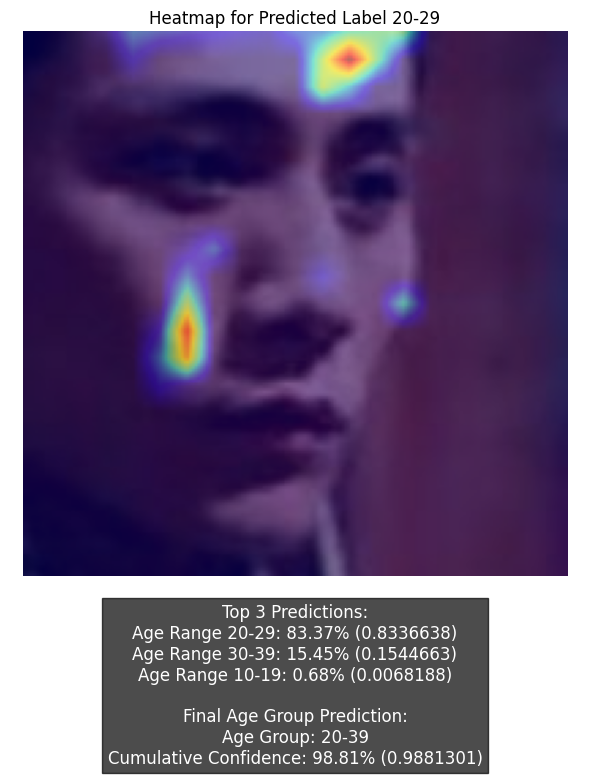

Top 3 Predictions:
Age Range 40-49: 39.59% (0.3959476)
Age Range 30-39: 37.85% (0.3785053)
Age Range 50-59: 10.59% (0.1059315)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 98.17% (0.9817261)


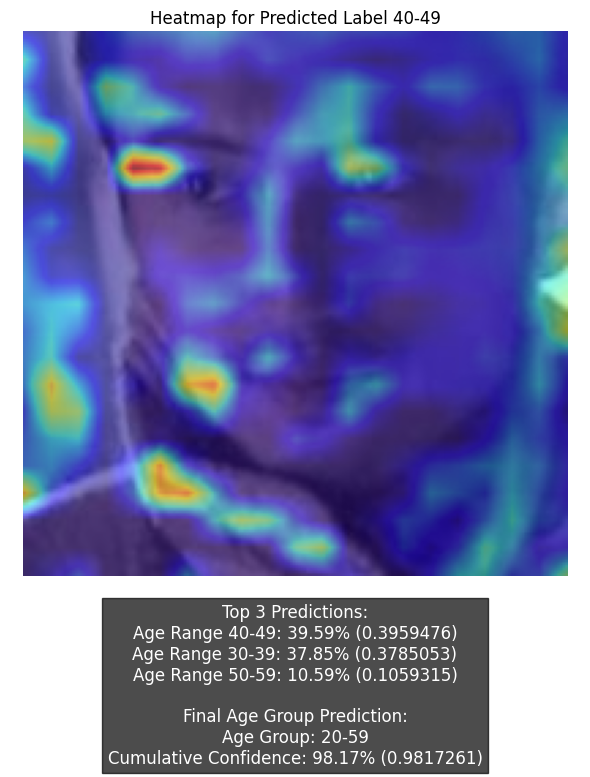

Top 3 Predictions:
Age Range 40-49: 58.10% (0.5810275)
Age Range 30-39: 22.82% (0.2281814)
Age Range 50-59: 15.55% (0.1555070)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.47% (0.9647159)


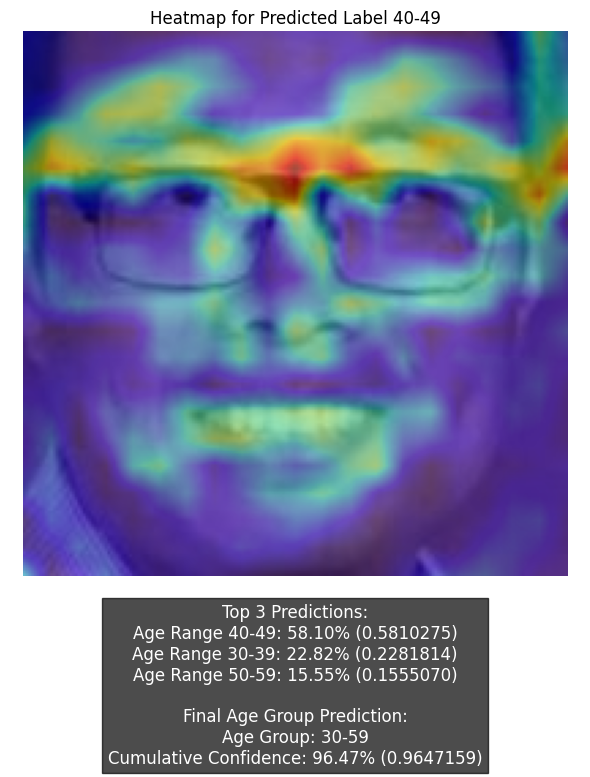

Top 3 Predictions:
Age Range 50-59: 33.13% (0.3312667)
Age Range 40-49: 31.78% (0.3177734)
Age Range 30-39: 15.74% (0.1574221)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 94.66% (0.9466437)


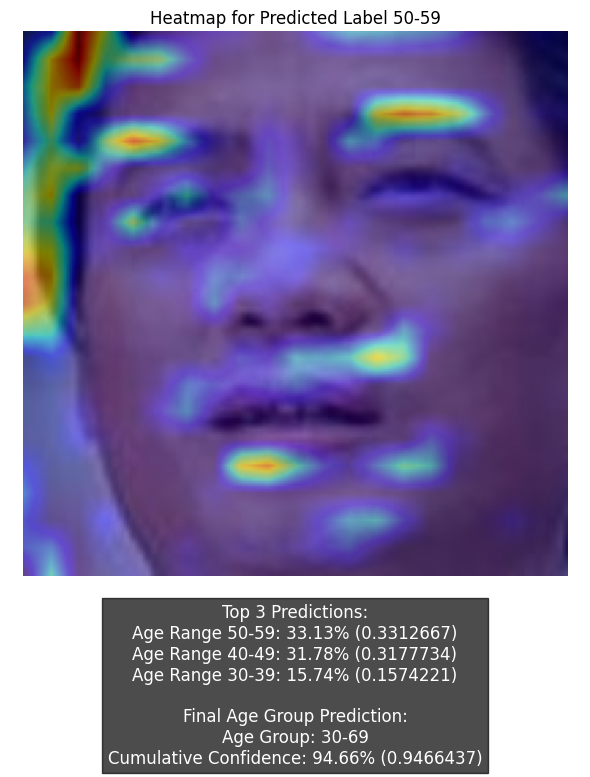

Top 3 Predictions:
Age Range 20-29: 87.23% (0.8723024)
Age Range 30-39: 10.55% (0.1055132)
Age Range 10-19: 1.93% (0.0193306)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 97.78% (0.9778155)


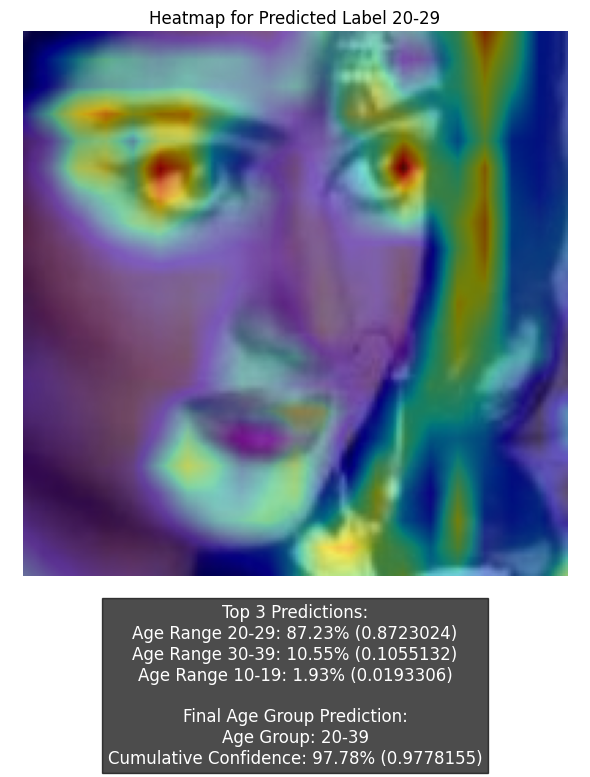

Top 3 Predictions:
Age Range 50-59: 44.27% (0.4427159)
Age Range 40-49: 25.69% (0.2569428)
Age Range 60-69: 19.92% (0.1991930)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 95.94% (0.9593831)


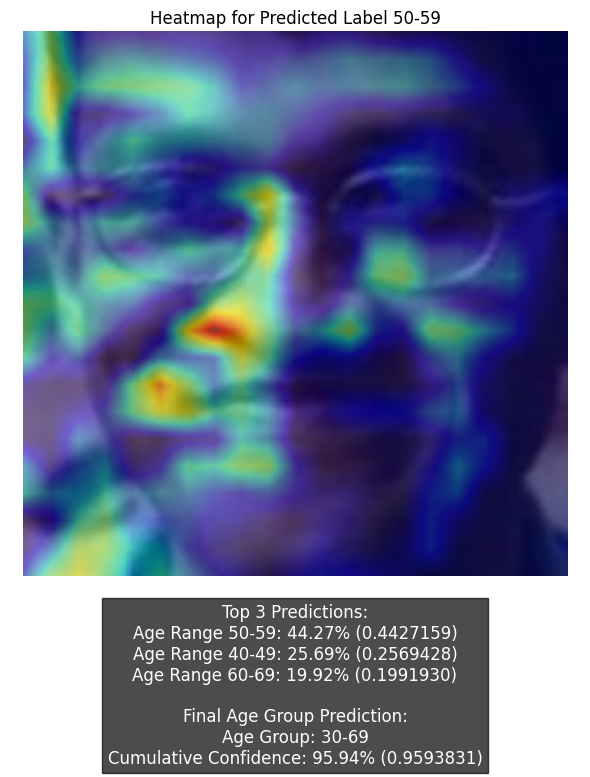

Top 3 Predictions:
Age Range 40-49: 69.17% (0.6916978)
Age Range 30-39: 15.98% (0.1597585)
Age Range 50-59: 13.24% (0.1324364)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 98.39% (0.9838927)


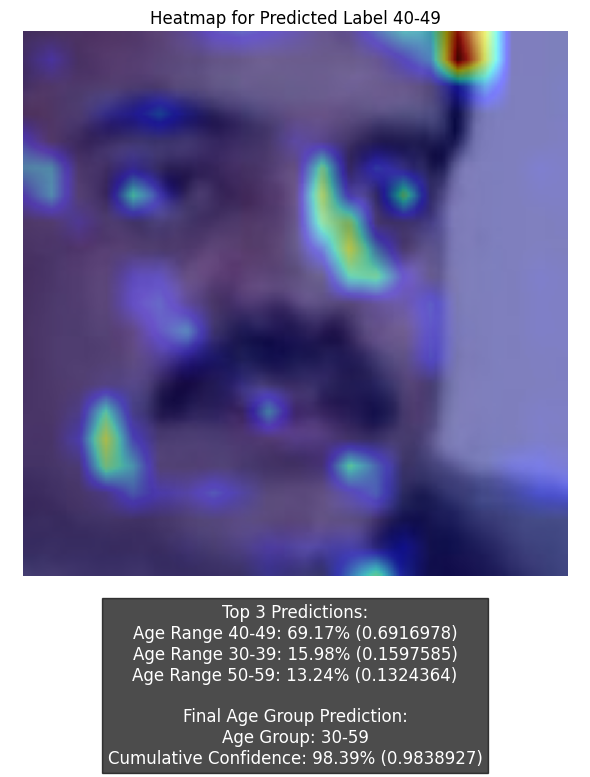

Top 3 Predictions:
Age Range 60-69: 32.45% (0.3244604)
Age Range 70-79: 29.38% (0.2937894)
Age Range 50-59: 22.81% (0.2280920)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 98.09% (0.9809235)


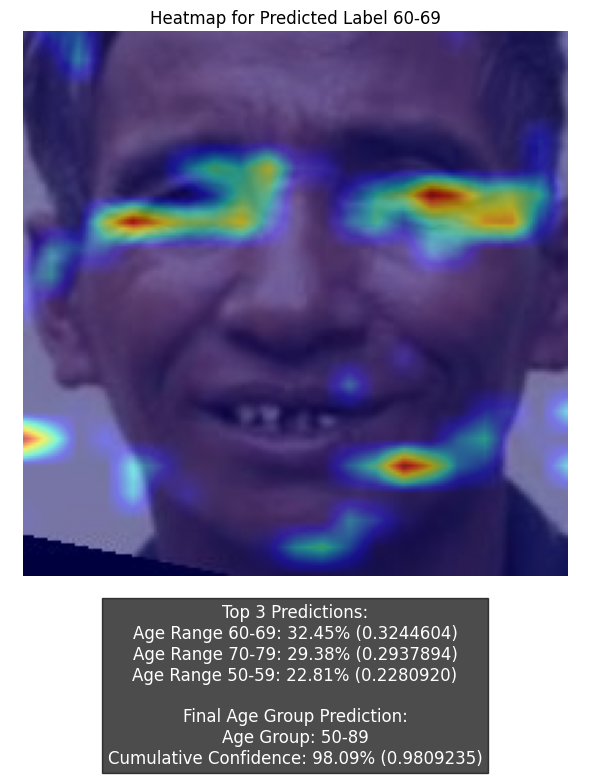

Top 3 Predictions:
Age Range 20-29: 80.20% (0.8020315)
Age Range 30-39: 17.33% (0.1733435)
Age Range 10-19: 1.56% (0.0155896)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 97.54% (0.9753751)


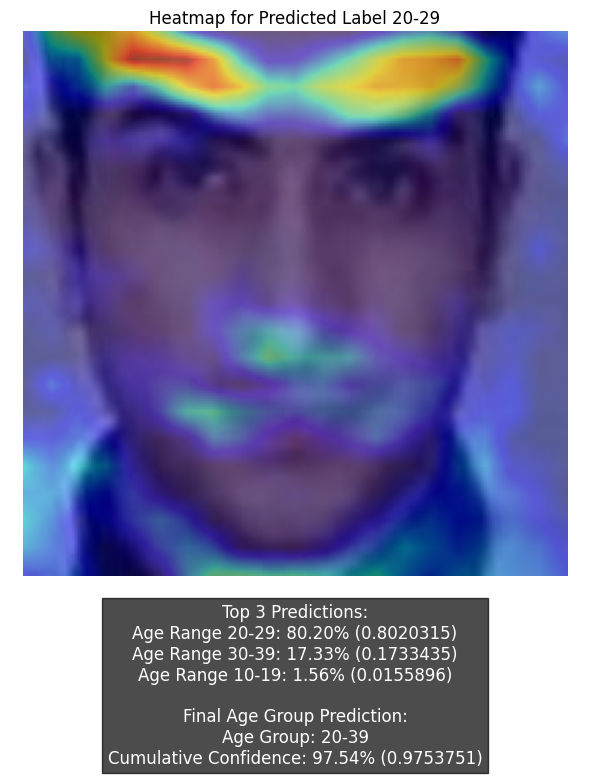

Top 3 Predictions:
Age Range 50-59: 35.26% (0.3525992)
Age Range 40-49: 28.28% (0.2827558)
Age Range 60-69: 16.30% (0.1629632)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 93.60% (0.9360192)


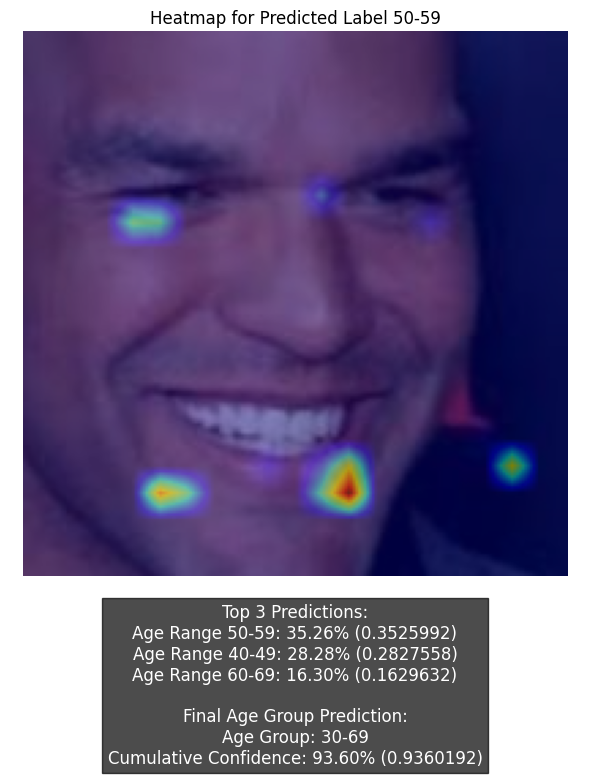

Top 3 Predictions:
Age Range 40-49: 58.72% (0.5871880)
Age Range 50-59: 29.69% (0.2969456)
Age Range 30-39: 7.02% (0.0702031)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 95.43% (0.9543367)


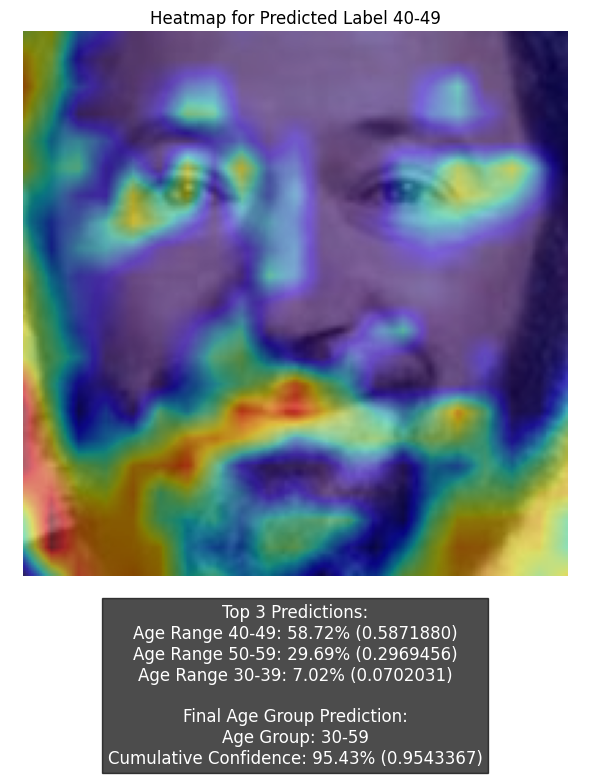

Top 3 Predictions:
Age Range 50-59: 43.21% (0.4321195)
Age Range 40-49: 26.44% (0.2643549)
Age Range 60-69: 20.27% (0.2027379)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 95.83% (0.9583241)


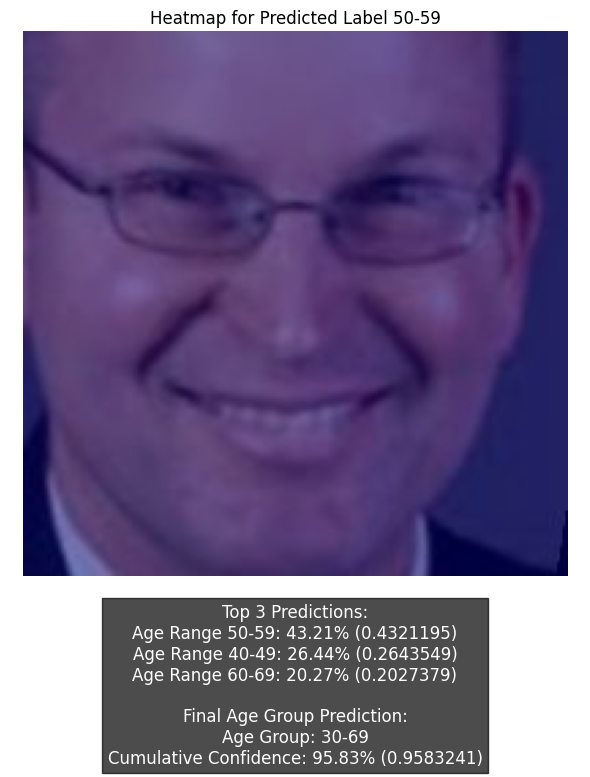

Top 3 Predictions:
Age Range 20-29: 88.16% (0.8816060)
Age Range 30-39: 9.12% (0.0911919)
Age Range 10-19: 2.48% (0.0248245)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 97.28% (0.9727980)


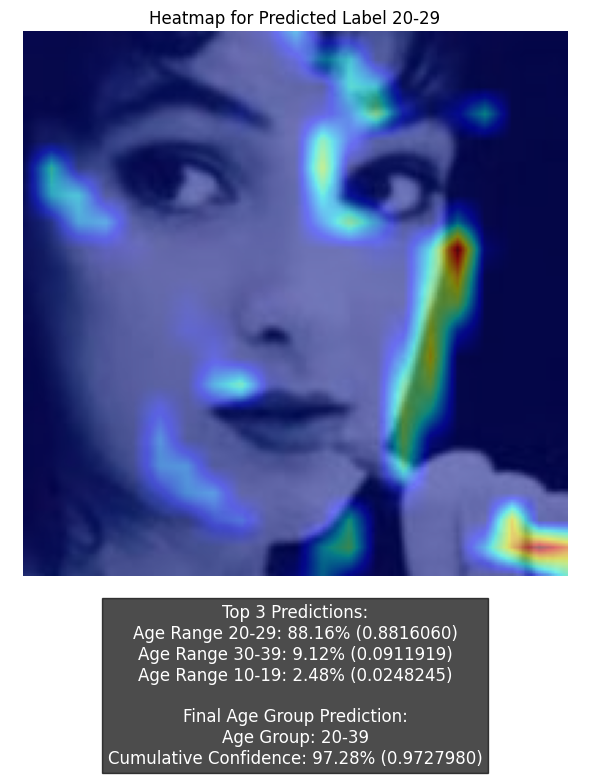

Top 3 Predictions:
Age Range 60-69: 35.15% (0.3514948)
Age Range 50-59: 27.12% (0.2712188)
Age Range 70-79: 24.06% (0.2405909)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 96.15% (0.9614812)


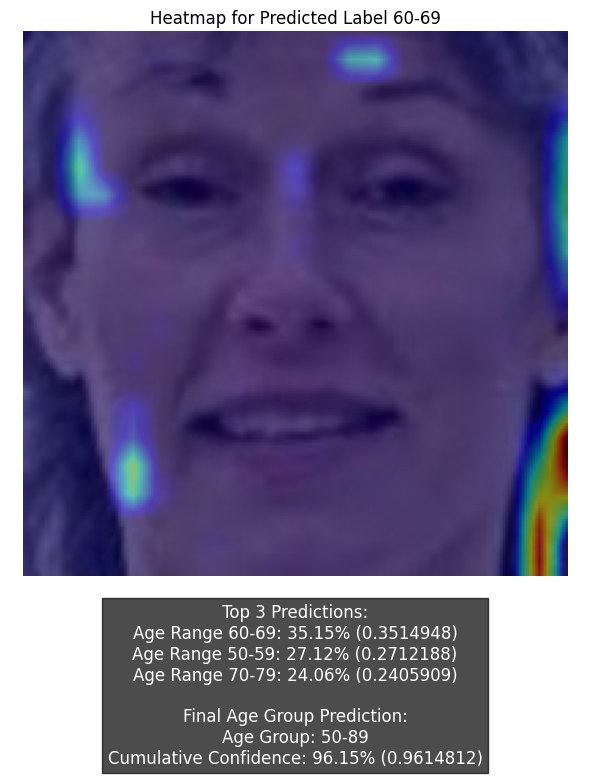

Top 3 Predictions:
Age Range 40-49: 54.48% (0.5448291)
Age Range 30-39: 32.88% (0.3287509)
Age Range 50-59: 8.96% (0.0895681)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 96.31% (0.9631481)


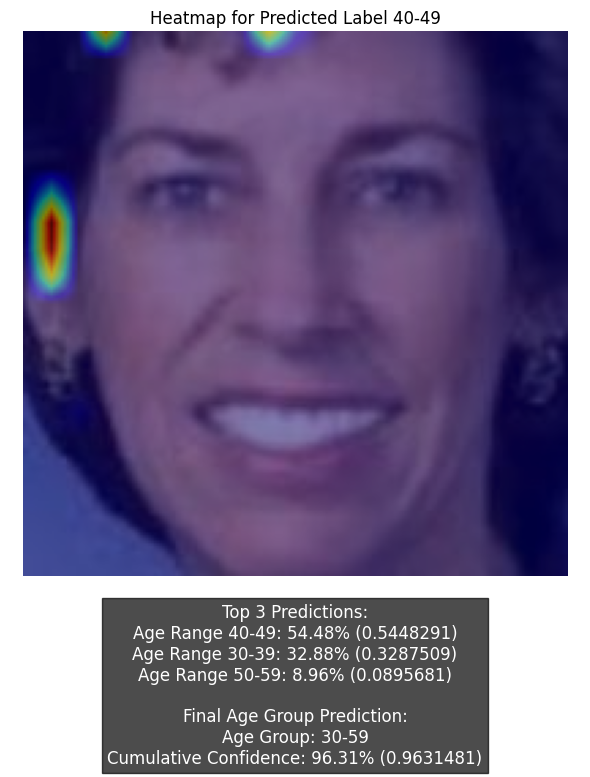

Top 3 Predictions:
Age Range 70-79: 34.55% (0.3454910)
Age Range 80-89: 28.86% (0.2885566)
Age Range 60-69: 26.22% (0.2622437)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 99.23% (0.9922836)


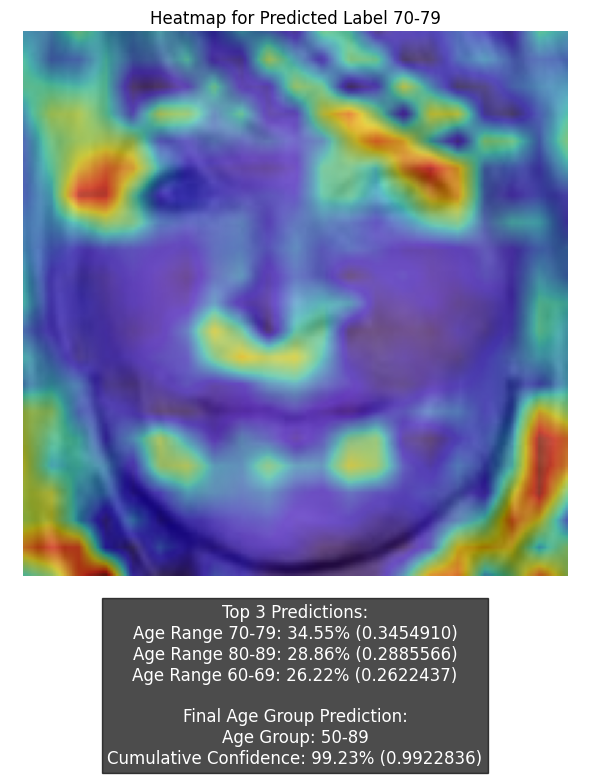

Top 3 Predictions:
Age Range 20-29: 79.63% (0.7963164)
Age Range 10-19: 10.72% (0.1071985)
Age Range 30-39: 9.27% (0.0927227)

Final Age Group Prediction:
Age Group: 10-29
Cumulative Confidence: 90.35% (0.9035149)


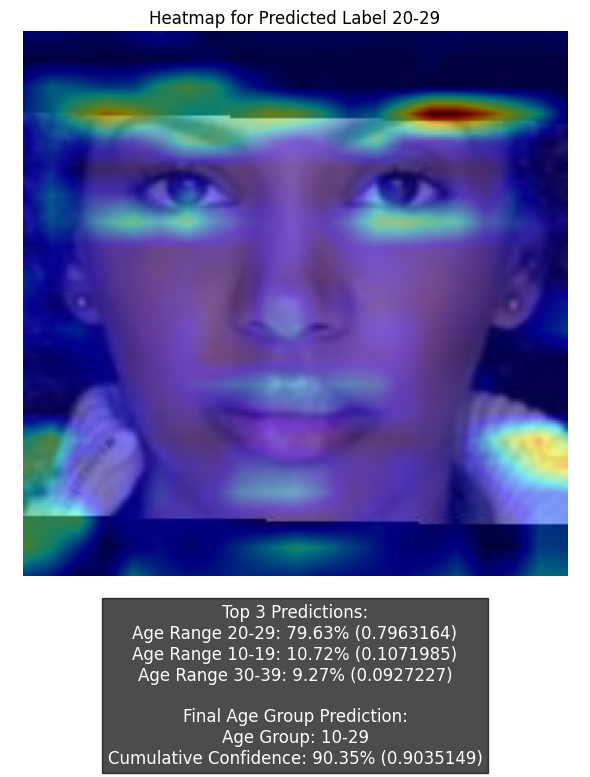

Top 3 Predictions:
Age Range 50-59: 30.36% (0.3035547)
Age Range 40-49: 20.37% (0.2037288)
Age Range 60-69: 18.58% (0.1857820)

Final Age Group Prediction:
Age Group: 20-69
Cumulative Confidence: 90.99% (0.9099429)


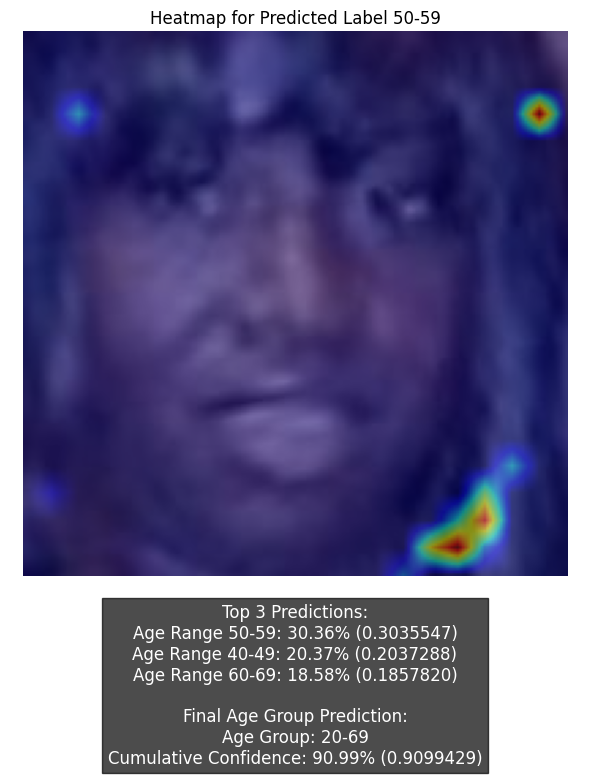

Top 3 Predictions:
Age Range 40-49: 44.02% (0.4402107)
Age Range 30-39: 37.40% (0.3739508)
Age Range 50-59: 10.04% (0.1003678)

Final Age Group Prediction:
Age Group: 30-59
Cumulative Confidence: 91.45% (0.9145293)


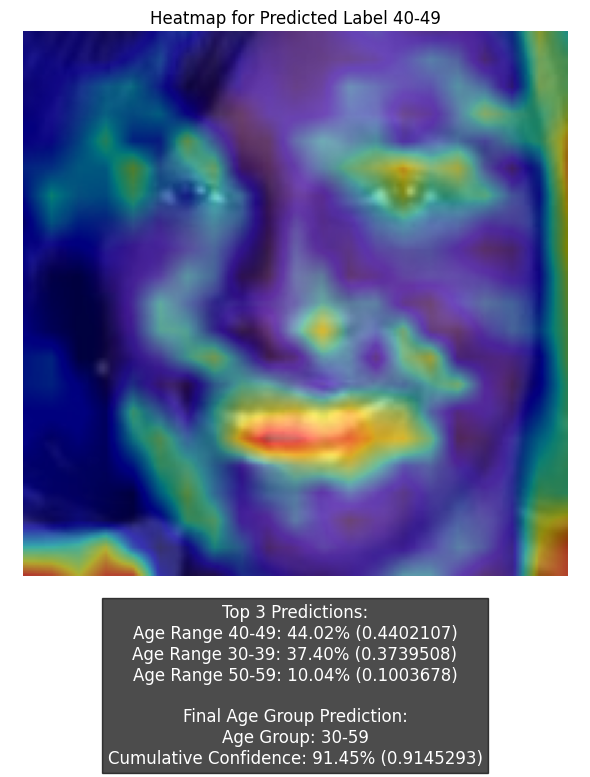

Top 3 Predictions:
Age Range 70-79: 29.04% (0.2904135)
Age Range 60-69: 28.56% (0.2855678)
Age Range 80-89: 25.76% (0.2575840)

Final Age Group Prediction:
Age Group: 50-89
Cumulative Confidence: 96.95% (0.9694874)


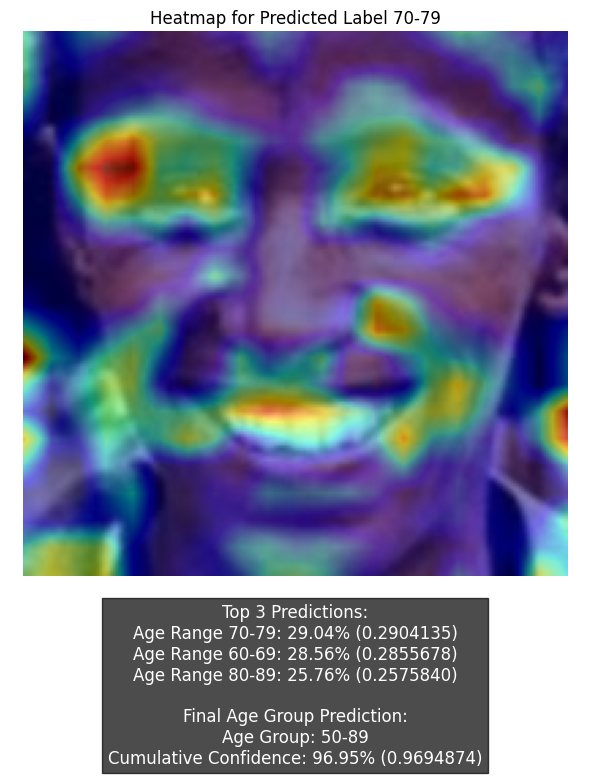

Top 3 Predictions:
Age Range 20-29: 93.46% (0.9346116)
Age Range 10-19: 3.39% (0.0339386)
Age Range 30-39: 3.13% (0.0313152)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 93.46% (0.9346116)


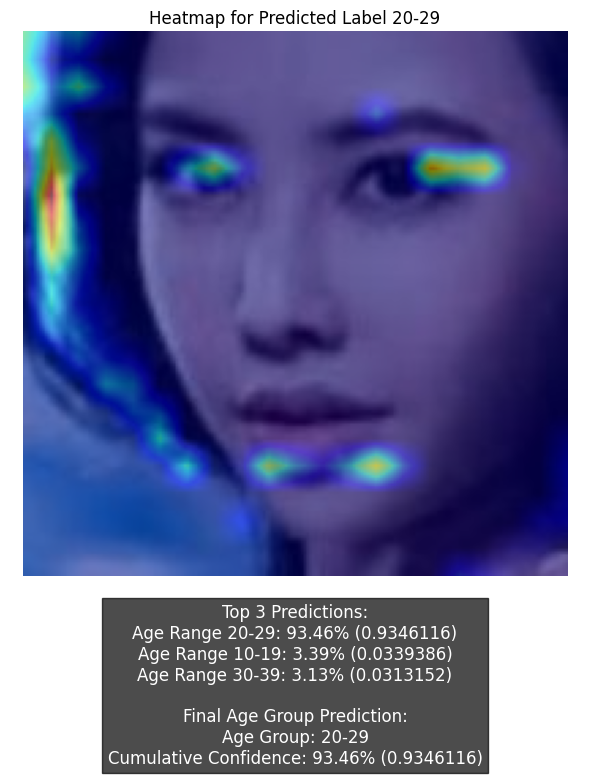

Top 3 Predictions:
Age Range 40-49: 41.23% (0.4123400)
Age Range 30-39: 37.31% (0.3731233)
Age Range 50-59: 10.52% (0.1052302)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 98.08% (0.9807966)


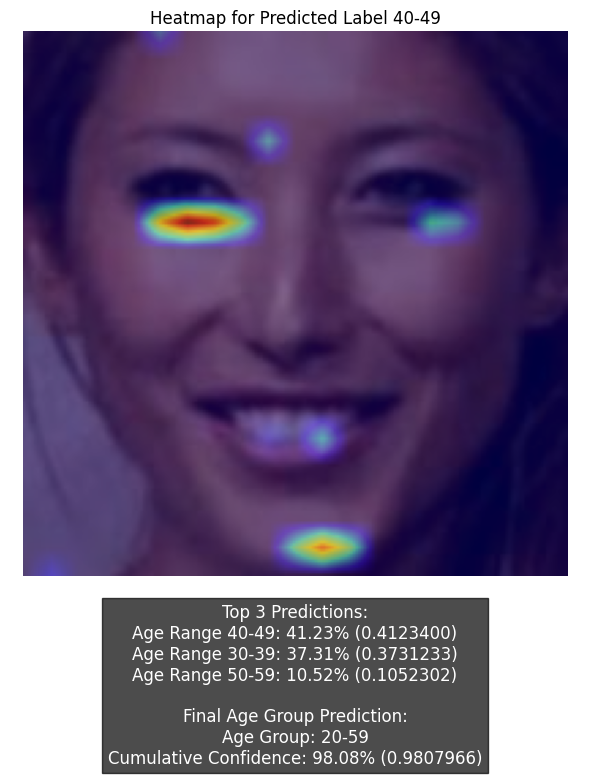

Top 3 Predictions:
Age Range 40-49: 31.23% (0.3123113)
Age Range 50-59: 26.39% (0.2638562)
Age Range 30-39: 21.89% (0.2189146)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 91.07% (0.9107058)


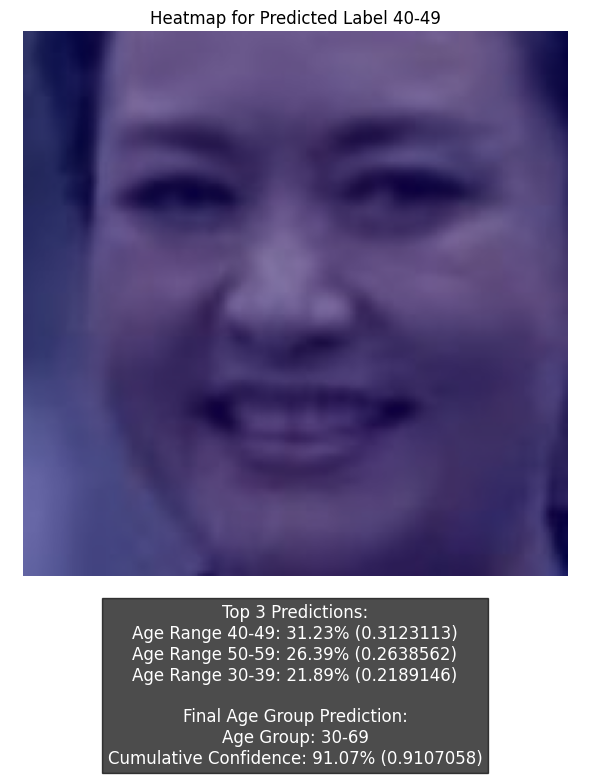

Top 3 Predictions:
Age Range 60-69: 35.52% (0.3552431)
Age Range 50-59: 32.45% (0.3245489)
Age Range 70-79: 16.10% (0.1609946)

Final Age Group Prediction:
Age Group: 40-79
Cumulative Confidence: 91.52% (0.9151868)


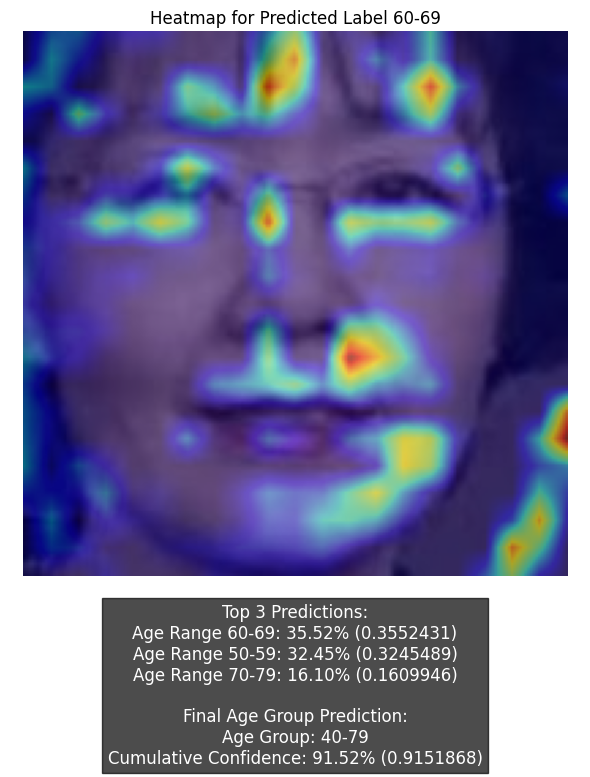

Top 3 Predictions:
Age Range 20-29: 92.38% (0.9237678)
Age Range 30-39: 6.00% (0.0600343)
Age Range 10-19: 1.57% (0.0157461)

Final Age Group Prediction:
Age Group: 20-29
Cumulative Confidence: 92.38% (0.9237678)


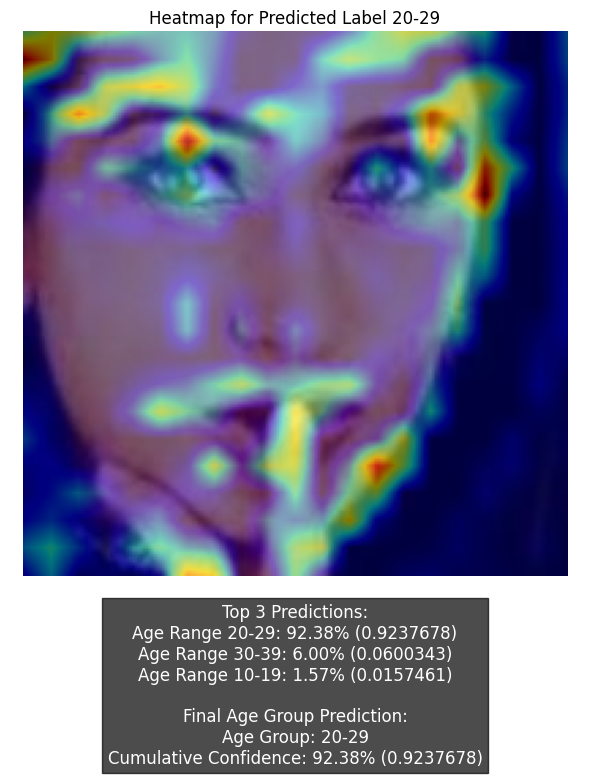

Top 3 Predictions:
Age Range 50-59: 30.46% (0.3045780)
Age Range 40-49: 29.62% (0.2961752)
Age Range 30-39: 17.02% (0.1701637)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 92.52% (0.9251593)


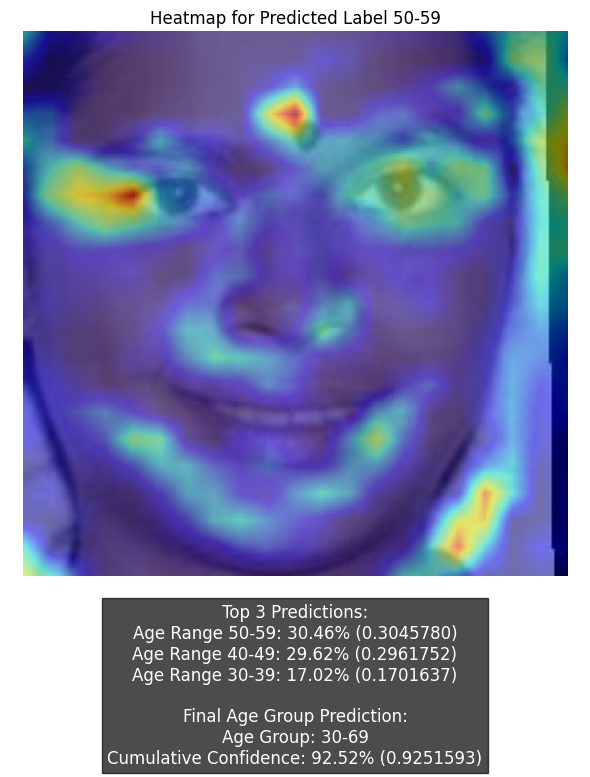

Top 3 Predictions:
Age Range 40-49: 36.76% (0.3676266)
Age Range 30-39: 24.51% (0.2450664)
Age Range 50-59: 23.40% (0.2340252)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 92.34% (0.9234198)


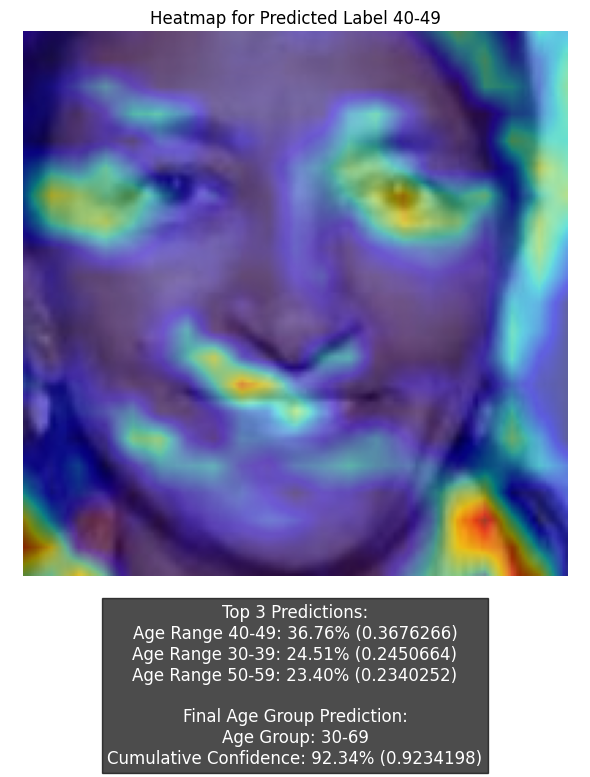

Top 3 Predictions:
Age Range 50-59: 32.65% (0.3264816)
Age Range 40-49: 30.19% (0.3018621)
Age Range 30-39: 15.72% (0.1571963)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 93.84% (0.9383630)


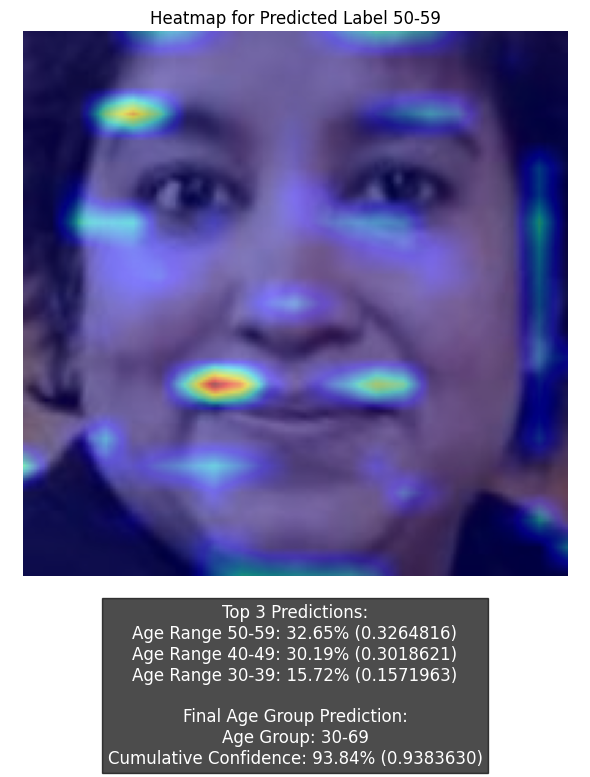

Top 3 Predictions:
Age Range 20-29: 84.74% (0.8474374)
Age Range 30-39: 13.55% (0.1355418)
Age Range 10-19: 1.14% (0.0114282)

Final Age Group Prediction:
Age Group: 20-39
Cumulative Confidence: 98.30% (0.9829791)


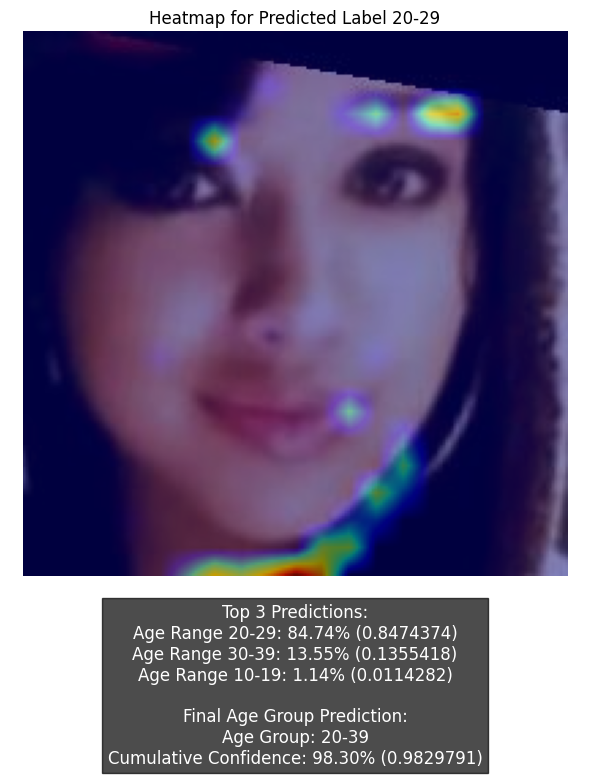

Top 3 Predictions:
Age Range 60-69: 26.23% (0.2622544)
Age Range 10-19: 17.66% (0.1765666)
Age Range 0-9: 15.34% (0.1533968)

Final Age Group Prediction:
Age Group: 0-89
Cumulative Confidence: 90.32% (0.9032301)


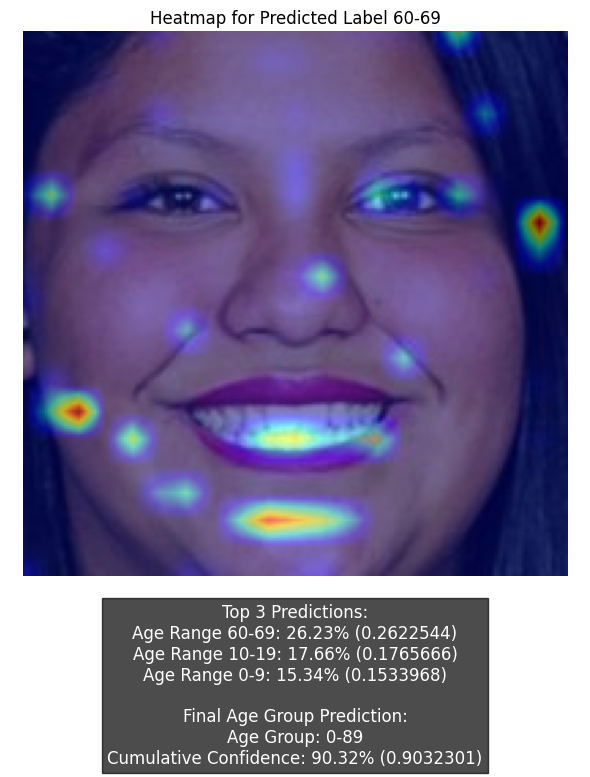

Top 3 Predictions:
Age Range 40-49: 38.44% (0.3844162)
Age Range 30-39: 36.45% (0.3644551)
Age Range 50-59: 12.00% (0.1200020)

Final Age Group Prediction:
Age Group: 20-59
Cumulative Confidence: 96.61% (0.9661328)


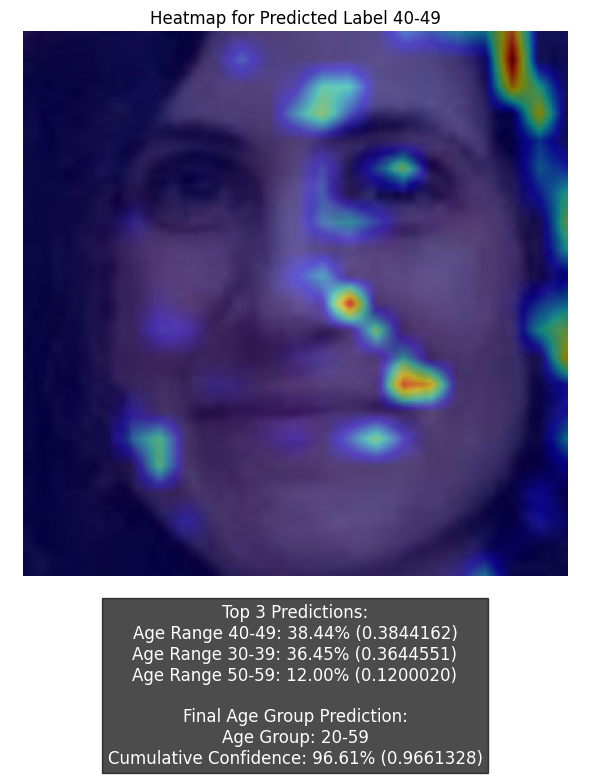

Top 3 Predictions:
Age Range 40-49: 33.86% (0.3386207)
Age Range 50-59: 25.27% (0.2526537)
Age Range 30-39: 24.00% (0.2400071)

Final Age Group Prediction:
Age Group: 30-69
Cumulative Confidence: 91.71% (0.9170850)


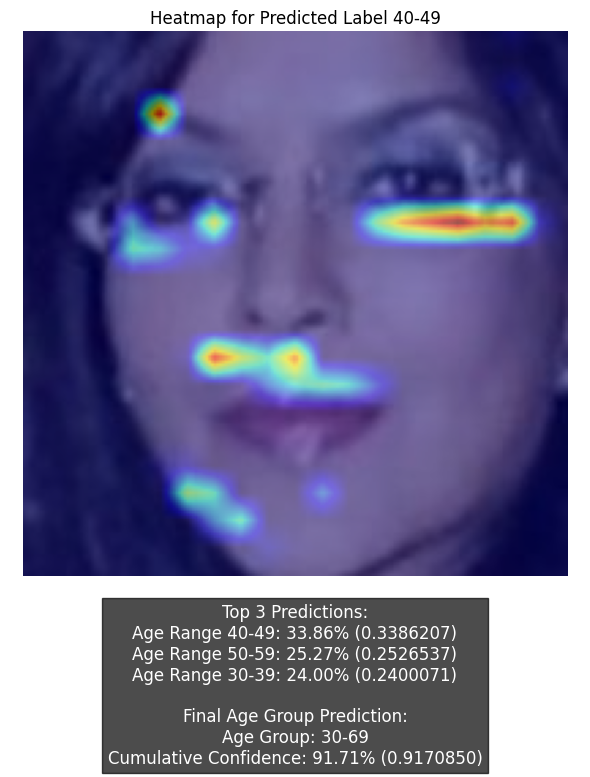

In [13]:
df_to_process_balanced = pd.read_csv('balanced_model_prototypes_and_criticisms.csv')

for index, row in df_to_process_balanced.iterrows():
    prototype_image_path = row['Prototype_Image_Path']
    criticism_image_path = row['Criticism_Image_Path']
    
    prototype_save_file = f"images/prototypes_and_criticisms/balanced_heatmap_prototype_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    criticism_save_file = f"images/prototypes_and_criticisms/balanced_heatmap_criticism_{row['Ethnicity']}_{row['Gender']}_{row['Ground_Truth_Age_Class']}_{index}.jpg"
    
    predict_xai(balanced_model, prototype_image_path, plot_heatmap=True, save_file=prototype_save_file)
    predict_xai(balanced_model, criticism_image_path, plot_heatmap=True, save_file=criticism_save_file)

In [ ]:
df_to_process = pd.read_csv('balanced_model_prototypes_and_criticisms.csv')

for index, row in df_to_process.iterrows():
    prototype_image_path = row['Prototype_Image_Path']